# PROJECT OVERVIEW

James M. Irving, Ph.D.

Flatiron Full Time Data Science 021119 Cohort

https://mybinder.org/v2/gh/jirvingphd/bs_ds/master

## MAIN QUESTION:
> #### **Can the Twitter activity of Donald Trump explain fluctuations in the stock market?**

**We will use a combination of traditional stock market forecasting combined with Natural Language Processing and word embeddings from President Trump's tweets to predict fluctuations in the stock market (using S&P 500 as index).**

- **Question 1: Can we predict if stock prices will go up or down at a fixed time point, based on the language in Trump's tweets?**
    - [NLP Model 0](#Model-0)<br><br>
    
- **Question 2: How well can explain stock market fluctuations using only historical price data?**
    - [Stock Market Model 1](#Model-1:-Using-Price-as-only-feature)<br><br>
- **Question 3: Does adding technical market indicators to our model improve its ability to predict stock prices?**
    - [Stock Market Model 2](#Model-2:-Stock-Price-+-Technical-Indicators)<br><br>
- **Question 4: Can the NLP predictions from Question 1, combined with all of the features from Question 3, as well as additional information regarding Trump's Tweets explain even more of the stock market fluctuations?**
    - Stock Market Model 3
    - Stock Market Model X<br><br>

    
### REFERENCES / INSPIRATION:

1. **Stanford Scientific Poster Using NLP ALONE to predict if stock prices increase or decrease 5 mins after Trump tweets.**  
    - [Poster PDF LINK](http://cs229.stanford.edu/proj2017/final-posters/5140843.pdf)
    - Best accuracy was X, goal 1 is to create a classifier on a longer timescale with superior results.
    

2. **TowardsDataScience Blog Plost on "Using the latest advancements in deep learning to predict stock price movements."** 
     - [Blog Post link](https://towardsdatascience.com/aifortrading-2edd6fac689d)

## OVERVIEW OF DATA/FEATURES USED PER MODEL


#### TWITTER DATA - CLASSIFICATION MODEL
**Trained Word2Vec embeddings on collection of Donal Trump's Tweets.**
- Used negative skip-gram method and negative sampling to best represent infrequently used words.
    
**Classified tweets based on change in stock price (delta_price)**
- Calculated price change from time of tweet to 60 mins later.
    - "No Change" if the delta price was < \\$0.05 
    - "Increase" if delta price was >+\\$0.05
    - "Decrease if delta price was >-\\$0.05
    
*NOTE: This model's predictions will become a feature in our final model.*


## OSEMN FRAMEWORK

# OBTAIN

### DATA SOURCES:

* **All Donald Trump tweets from 12/01/2016 (pre-inaugaration day) to end of 08/23/2018**
    *          Extracted from http://www.trumptwitterarchive.com/

* **Minute-resolution data for the S&P500 covering the same time period.**
    *         IVE S&P500 Index from - http://www.kibot.com/free_historical_data.aspx
    
    
* NOTE: Both sources required manual extraction and both 1-min historical stock data and batch-historical-tweet data are difficult to obtain without paying \\$150-\\$2000 monthly developer memberships. 

# SCRUB

In [1]:
# !pip install -U cufflinks

In [2]:
import os,sys
sys.path.append('py_files/')

In [3]:
## IMPORT MY PUBLISHED PYPI PACKAGE 
import bs_ds as  bs
!pip install -U fsds_100719
from fsds_100719.imports import *

# import bs_ds_local as bs
# from bs_ds.imports import *

fsds_1007219  v0.7.21 loaded.  Read the docs: https://fsds.readthedocs.io/en/latest/ 


Handle,Package,Description
dp,IPython.display,Display modules with helpful display and clearing commands.
fs,fsds_100719,Custom data science bootcamp student package
mpl,matplotlib,Matplotlib's base OOP module with formatting artists
plt,matplotlib.pyplot,Matplotlib's matlab-like plotting module
np,numpy,scientific computing with Python
pd,pandas,High performance data structures and tools
sns,seaborn,High-level data visualization library based on matplotlib


[i] Pandas .iplot() method activated.


In [4]:
## IMPORT CUSTOM CAPSTONE FUNCTIONS
import functions_combined_BEST as ji
import functions_io as io

from functions_combined_BEST import ihelp, ihelp_menu,\
reload, inspect_variables

In [5]:
## IMPORT CONVENIENCE/DISPLAY FUNCTIONS
from pprint import pprint
import qgrid
import json
import ipywidgets as widgets

In [6]:
# Import plotly and cufflinks for iplots
import plotly
import cufflinks as cf
from plotly import graph_objs as go
from plotly.offline import iplot
cf.go_offline()

In [7]:
# Suppress warnings
import warnings
warnings.filterwarnings('ignore')

#Set pd.set_options for tweet visibility
pd.set_option('display.max_colwidth',100)
pd.set_option('display.max_columns',50)

## Saving the sys.stdout to restore later
import sys
__stdout__=sys.stdout

# file_dict = io.def_filename_dictionary(load_prior=False, save_directory=True)

In [8]:
os.listdir()

['output_59_3.png',
 'output_60_7.png',
 'output_80_3.png',
 'py_files',
 'output_66_3.png',
 'output_38_0.png',
 'output_59_5.png',
 'output_66_7.png',
 '.DS_Store',
 'app2.py',
 'output_60_3.png',
 'Capstone_Adapted.ipynb',
 'Images',
 'readme_resources',
 'notebook_app.ipynb',
 'output_128_3.png',
 'SP500_1min_03_27_2020.xlsx',
 'keras_hyperparameter_tuning.ipynb',
 'models',
 '__pycache__',
 'README.md',
 'output_122_3.png',
 'output_54_5.png',
 'results',
 'SP500_1min_03_27_2020.csv',
 'Capstone_Adapted-SG.ipynb',
 '.gitignore',
 'output_74_3.png',
 'output_33_1.png',
 'figures',
 'output_54_3.png',
 'output_94_3.png',
 '.gitattributes',
 '.ipynb_checkpoints',
 'output_32_0.png',
 'output_88_3.png',
 '.git',
 'Capstone_Adapted-SG-ONLY CODE.ipynb',
 'data',
 'assets',
 'output_36_0.png']

## TRUMP'S TWEETS

### Natural Language Processing Info



To prepare Donal Trump's tweets for modeling, **it is essential to preprocess the text** and simplify its contents.
<br><br>
1. **At a minimum, things like:**
    - punctuation
    - numbers
    - upper vs lowercase letters<br>
    ***must*** be addressed before any initial analyses. I refer tho this initial cleaning as **"minimal cleaning"** of the text content<br>
    
> Version 1 of the tweet processing removes these items, as well as the removal of any urls in a tweet. The resulting data column is referred to here as "content_min_clean".

<br><br>
2. It is **always recommended** that go a step beyond this and<br> remove **commonly used words that contain little information** <br>for our machine learning algorithms. Words like: (the,was,he,she, it,etc.)<br> are called **"stopwords"**, and it is critical to address them as well.

> Version 2 of the tweet processing removes these items and the resulting data column is referred here as `cleaned_stopped_content`

<br>

3. Additionally, many analyses **need the text tokenzied** into a list of words<br> and not in a natural sentence format. Instead, they are a list of words (**tokens**) separated by ",", which tells the algorithm what should be considered one word.<br><br>For the tweet processing, I used a version of tokenization, called `regexp_tokenziation` <br>which uses pattern of letters and symbols (the `expression`) <br>that indicate what combination of alpha numeric characters should be considered a single token.<br><br>The pattern I used was `"([a-zA-Z]+(?:'[a-z]+)?)"`, which allows for words such as "can't" that contain "'" in the middle of word. This processes was actually applied in order to process Version 1 and 2 of the Tweets, but the resulting text was put back into sentence form. 

> Version 3 of the tweets keeps the text in their regexp-tokenized form and is reffered to as `cleaned_stopped_tokens`
<br>

4. While not always required, it is often a good idea to reduce similar words down to a shared core.
There are often **multiple variants of the same word with the same/simiar meaning**,<br> but one may plural **(i.e. "democrat" and "democrats")**, or form of words is different **(i.e. run, running).**<br> Simplifying words down to the basic core word (or word *stem*) is referred to as **"stemming"**. <br><br> A more advanced form of this also understands things like words that are just in a **different tense** such as  i.e.  **"ran", "run", "running"**. This process is called  **"lemmatization**, where the words are reduced to their simplest form, called "**lemmas**"<br>  
> Version 4 of the tweets are all reduced down to their word lemmas, futher aiding the algorithm in learning the meaning of the texts.


### Tweet Processing

In [9]:
reload(ji)
func_list = [ji.load_raw_twitter_file,
           ji.make_stopwords_list,
           ji.full_twitter_df_processing,
           ji.full_sentiment_analysis]
ji.ihelp_menu(func_list)

# ji.save_ihelp_menu_to_file(func_list,filename='_twitter_processing')

GridBox(box_style='warning', children=(HBox(children=(Label(value='Function Menu'), Dropdown(options=('load_ra…

Output()

In [10]:
# from functions_combined_BEST import ihelp_menu2
# # file_dict = ji.load_filename_directory()
tweets = 'data/trump_tweets_12012016_to_01012020.csv'
sp500 = 'data/SP500_1min_01_23_2020.xlsx'
# dft = pd.read_csv(tweets)
# dfs = pd.read_excel(sp500)
np.random.seed(42)

In [11]:
fs.ihelp(ji.load_raw_twitter_file)

------------------------------------------------------------------------------------
------ HELP ------------------------------------------------------------------------

Help on function load_raw_twitter_file in module functions_nlp:

load_raw_twitter_file(filename='data/trumptwitterarchive_export_iphone_only__08_23_2019.csv', date_as_index=True, rename_map={'text': 'content', 'created_at': 'date'})
    import raw copy and pasted to csv export from http://www.trumptwitterarchive.com/archive. 
    Rename columns indicated in rename_map and sets the index to a datetimeindex copy of date column.

------------------------------------------------------------------------------------
------ SOURCE ----------------------------------------------------------------------


```python
def load_raw_twitter_file(filename ='data/trumptwitterarchive_export_iphone_only__08_23_2019.csv', date_as_index=True,rename_map={'text':'content','created_at':'date'}): 
    """import raw copy and pasted to csv export from http://www.trumptwitterarchive.com/archive. 
    Rename columns indicated in rename_map and sets the index to a datetimeindex copy of date column."""    
    # old link'data/trump_tweets_01202017_06202019.csv'
    import pandas as pd
    print(f'[io] Loading raw tweet text file: {filename}')
    df = pd.read_csv(filename, encoding='utf-8')
    mapper=rename_map
    df.rename(axis=1,mapper=mapper,inplace=True)
    df['date']=pd.to_datetime(df['date'])
    if date_as_index==True:
        df.set_index('date',inplace=True,drop=False)
    # df.head()
    return df

```

In [12]:
## Process twitter data: 

# ## Load in raw csv of twitter_data, create date_time_index, rename columns
# twitter_df =pd.read_csv('data/trump_tweets_12012016_to_01012020.csv',
#                         encoding='utf-8')
# twitter_df.rename(mapper={'text':'content','created_at':'date'},axis=1)


twitter_df = ji.load_raw_twitter_file(filename=tweets, 
                         date_as_index=True,
                         rename_map={'text': 'content',
                                     'created_at': 'date'})
twitter_df.head()

[io] Loading raw tweet text file: data/trump_tweets_12012016_to_01012020.csv


,source,content,date,retweet_count,favorite_count,is_retweet,id_str
date,,,,,,,
2020-01-01 03:12:07,Twitter Media Studio,https://t.co/EVAEYD1AgV,2020-01-01 03:12:07,25016,108830,False,1212209862094012416
2020-01-01 01:30:35,Twitter for iPhone,HAPPY NEW YEAR!,2020-01-01 01:30:35,85409,576045,False,1212184310389850119
2020-01-01 01:22:28,Twitter for iPhone,Our fantastic First Lady! https://t.co/6iswto4WDI,2020-01-01 01:22:28,27567,132633,False,1212182267113680896
2020-01-01 01:18:47,Twitter for iPhone,RT @DanScavino: https://t.co/CJRPySkF1Z,2020-01-01 01:18:47,10796,0,True,1212181341078458369
2020-01-01 01:17:43,Twitter for iPhone,RT @SenJohnKennedy: I think Speaker Pelosi is having 2nd thoughts about impeaching the President...,2020-01-01 01:17:43,8893,0,True,1212181071988703232


In [13]:
import cufflinks as cf
cf.go_offline()

In [14]:
import nltk
nltk.download('wordnet')
nltk.download('vader_lexicon')

[nltk_data] Downloading package wordnet to
[nltk_data]     /Users/jamesirving/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package vader_lexicon to
[nltk_data]     /Users/jamesirving/nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!


True

In [15]:
# fs.ihelp(ji.full_twitter_df_processing,0)
# twitter_df.head()

In [16]:
# import re
# from nltk import regexp_tokenize
# pattern = "([a-zA-Z]+(?:'[a-z]+)?)"

# try:
#     df
# except NameError:
#     df = twitter_df.copy()
# raw_tweet_col='text'
# ## RETWEETS
# # Creating columns for tweets that `has_RT` or `starts_RT`
# df['has_RT']=df[raw_tweet_col].str.contains('RT')
# df['starts_RT']=df[raw_tweet_col].str.contains('^RT')

# ## FIRST REMOVE THE RT HEADERS
# # Remove `RT @Mentions` FIRST:
# re_RT = re.compile('RT [@]?\w*:')

# check_content_col = raw_tweet_col
# 'fill_content_col = cleaned_tweet_col'

# df['content_starts_RT'] = df[check_content_col].apply(lambda x: re_RT.findall(x))
# df[fill_content_col] =  df[check_content_col].apply(lambda x: re_RT.sub(' ',x))
# track_fill_content_col+=1


# ## URLS

# ## SECOND REMOVE URLS
# # Remove urls with regex
# urls = re.compile(r"(http[s]?://\w*\.\w*/+\w+)")

# if track_fill_content_col==0:
#     check_content_col = raw_tweet_col
# else:
#     check_content_col = fill_content_col

# fill_content_col = fill_content_col

# # df_full['content_urls'] = df_full[check_content_col].apply(lambda x: urls.findall(x))
# df[fill_content_col] =  df[check_content_col].apply(lambda x: urls.sub('',x))

# ## SAVE THIS MINIMALLY CLEANED CONTENT AS 'content_min_clean'
# df['content_min_clean'] =  df[fill_content_col]
# track_fill_content_col+=1


# ## 08/25 ADDING REMOVAL OF PUNCATUATION to min clean @ And # SYMBOLS FOR MIN CLEAN

# ## Case Ratio Calculation (optional)
# # if use_col_for_case_ratio is None:
# use_col_for_case_ratio='content_min_clean'
# df['case_ratio'] = df[use_col_for_case_ratio].apply(lambda x: case_ratio(x))
# print(f'[i] case_ratio calculated from {use_col_for_case_ratio} before text to lowercase')


# def quick_fix(x):
#     import string
#     punc_list = string.punctuation
#     x = x.lower()
#     for punc in punc_list:
#         x = x.replace(punc,' ')
#     return x

# df['content_min_clean'] =   df['content_min_clean'].apply(lambda x: quick_fix(x)) #.replace('#',' '))
# print(f'[i] case->lower and punctuation removed from "content_min_clean" ' )



# ## Hashtags
# if track_fill_content_col==0:
#     check_content_col = raw_tweet_col
# else:
#     check_content_col = fill_content_col

# fill_content_col = fill_content_col

# ## REMOVE AND SAVE HASHTAGS, MENTIONS
# # Remove and save Hashtags
# hashtags = re.compile(r'\#\w*')

# df['content_hashtags'] =  df[check_content_col].apply(lambda x: hashtags.findall(x))
# df[fill_content_col] =  df[check_content_col].apply(lambda x: hashtags.sub(' ',x))
# track_fill_content_col+=1

# ## save_hashtags
# # if str_tags_mentions==True: 
# df['hashtag_strings'] = df['content_hashtags'].apply(lambda x: empty_lists_to_strings(x))


# ## mentions

# if track_fill_content_col==0:
#     check_content_col = raw_tweet_col
# else:
#     check_content_col = fill_content_col

# fill_content_col = fill_content_col

# # Remove and save mentions (@)'s
# mentions = re.compile(r'\@\w*')


# df['content_mentions'] =  df[check_content_col].apply(lambda x: mentions.findall(x))
# df[fill_content_col] =  df[check_content_col].apply(lambda x: mentions.sub(' ',x))
# track_fill_content_col+=1

# df['mention_strings'] = df['content_mentions'].apply(lambda x: empty_lists_to_strings(x))


# ## Creating content_stopped columns and then tokens_stopped column
# stop_col_name = fill_content_col+'_stop'
# print('[i] stopped text column: ',stop_col_name)

# stopped_tok_col_name =  fill_content_col+'_stop_tokens'

# print('[i] tokenized stopped text column: ',stopped_tok_col_name)

# # if len(stopwords_list)==0:
# stopwords_list=make_stopwords_list()

# df[stop_col_name] = df[fill_content_col].apply(lambda x: remove_stopwords(stopwords_list,x,tokenize=True, return_tokens=False, pattern=pattern))
# df[stopped_tok_col_name] = df[stop_col_name].apply(lambda x: remove_stopwords(stopwords_list,x,tokenize=True, return_tokens=True, pattern=pattern))

# # if lemmatize:
# # text_data = df[stopped_tok_col_name]
# df = get_tweet_lemmas(df, text_column=stopped_tok_col_name, name_for_lemma_col=name_for_lemma_col)
# print(f'[i] lemmaztied columns: {name_for_lemma_col}')

# # ## Calculate case ratio is non-default was used
# # if use_col_for_case_ratio is not None and 'content_min_clean' not in use_col_for_case_ratio:
# #     df['case_ratio'] = df[use_col_for_case_ratio].apply(lambda x: case_ratio(x))
# #     print(f'[i] case_ratio calculated from {use_col_for_case_ratio}')

# ## Sentiment Analysis (optional)
# if use_col_for_sentiment is not None:
#     df = full_sentiment_analysis(df,source_column=use_col_for_sentiment,separate_cols=True)

# df.sort_index(inplace=True)
# return df


In [17]:
# 1. create minimally cleaned column `content_min_clean` with urls
twitter_df = ji.full_twitter_df_processing(twitter_df,
                                           raw_tweet_col='content',
                                           name_for_cleaned_tweet_col='content_cleaned',
                                           name_for_stopped_col='cleaned_stopped_content', 
                                           name_for_tokenzied_stopped_col='cleaned_stopped_tokens',
                                           use_col_for_case_ratio='content', 
                                           use_col_for_sentiment='content_min_clean',
                                           RT=True, urls=True, hashtags=True, mentions=True,
                                           str_tags_mentions=True,force=True)
#                                            stopwords_list=frequent_words, force=True)
#                                            stopwords_list=stop_words, force=True)
## Display Index information
ji.index_report(twitter_df,label='twitter_df')

## Check for strings that exceed the correct tweet length
keep_idx = ji.check_length_string_column(twitter_df, 'content_min_clean',length_cutoff=400,display_describe=False)
## verify no issues arise.
if keep_idx.isna().sum()>0:
    raise Exception('')
else:
    twitter_df=twitter_df[keep_idx]
    print(f'removed {np.sum(keep_idx==False)}')

ji.check_length_string_column(twitter_df, 'content_min_clean',length_cutoff=400,return_keep_idx=False)
twitter_df.head(2)

[i] case_ratio calculated from content before text to lowercase
[i] case->lower and punctuation removed from "content_min_clean" 
[i] stopped text column:  cleaned_stopped_content
[i] tokenized stopped text column:  cleaned_stopped_tokens
[i] lemmaztied columns: cleaned_stopped_lemmas
------------------------------------------------------------
	INDEX REPORT:	twitter_df
------------------------------------------------------------
* Index Endpoints:
	2016-12-01 14:37:57 -- to -- 2020-01-01 03:12:07
* Index Freq:
	None
------------------------------------------------------------
	STRING LENGTH REPORT:	"content_min_clean" column
------------------------------------------------------------
[i] Found 2 # of strings above cutoff of 400 chars.
removed 2
------------------------------------------------------------
	STRING LENGTH REPORT:	"content_min_clean" column
------------------------------------------------------------
[i] Found 0 # of strings above cutoff of 400 chars.


,count,mean,std,min,25%,50%,75%,max
content_min_clean,14064,148.913,83.6571,0,96,127,229,310


,source,content,date,retweet_count,favorite_count,is_retweet,id_str,has_RT,starts_RT,content_starts_RT,content_cleaned,content_min_clean,case_ratio,content_hashtags,hashtag_strings,content_mentions,mention_strings,cleaned_stopped_content,cleaned_stopped_tokens,cleaned_stopped_lemmas,sentiment_scores,compound_score,sentiment_class,neg,neu,pos
date,,,,,,,,,,,,,,,,,,,,,,,,,,
2016-12-01 14:37:57,Twitter for iPhone,My thoughts and prayers are with those affected by the tragic storms and tornadoes in the Southe...,2016-12-01 14:37:57,12077,65724,False,804333718999539712,False,False,[],My thoughts and prayers are with those affected by the tragic storms and tornadoes in the Southe...,my thoughts and prayers are with those affected by the tragic storms and tornadoes in the southe...,0.03906,[],,[],,thoughts prayers affected tragic storms tornadoes southeastern united states stay safe,"[thoughts, prayers, affected, tragic, storms, tornadoes, southeastern, united, states, stay, safe]",thought prayer affected tragic storm tornado southeastern united state stay safe,"{'neg': 0.168, 'neu': 0.623, 'pos': 0.209, 'compound': 0.2732}",0.2732,pos,0.168,0.623,0.209
2016-12-01 14:38:09,Twitter for Android,Getting ready to leave for the Great State of Indiana and meet the hard working and wonderful pe...,2016-12-01 14:38:09,9834,57249,False,804333771021570048,False,False,[],Getting ready to leave for the Great State of Indiana and meet the hard working and wonderful pe...,getting ready to leave for the great state of indiana and meet the hard working and wonderful pe...,0.06034,[],,[],,getting ready leave great state indiana meet hard working wonderful people carrier c,"[getting, ready, leave, great, state, indiana, meet, hard, working, wonderful, people, carrier, c]",getting ready leave great state indiana meet hard working wonderful people carrier c,"{'neg': 0.093, 'neu': 0.538, 'pos': 0.369, 'compound': 0.8658}",0.8658,pos,0.093,0.538,0.369


### New - 09/21/19
- Removing 'starts_RT' tweets

In [18]:
display(twitter_df['is_retweet'].value_counts())

twitter_df = twitter_df.query('is_retweet == False')
display(twitter_df['is_retweet'].value_counts())

False    12339
True      1667
Name: is_retweet, dtype: int64

False    12339
Name: is_retweet, dtype: int64

In [19]:
# # Dropping columns about retweets
# drop_cols = ['has_RT','content_starts_RT','starts_RT']
# twitter_df.drop(drop_cols,axis=1,inplace=True)

In [20]:
ji.display_same_tweet_diff_cols(twitter_df)

#### TWEET FROM 05-15-2019 18:20:30:

* **["content"] column:**<p><blockquote>***"The courage &amp; sacrifice of our heroes is the reason our flag stands tall our hearts beat with pride and our Country remains one people one family and one NATION UNDER GOD. Today we thank you we honor you &amp; we forever cherish the memory of our Fallen Men and Women in Blue! https://t.co/ARHYgDVi3M"***

* **["content_min_clean"] column:**<p><blockquote>***"the courage  amp  sacrifice of our heroes is the reason our flag stands tall our hearts beat with pride and our country remains one people one family and one nation under god  today we thank you we honor you  amp  we forever cherish the memory of our fallen men and women in blue  "***

* **["cleaned_stopped_content"] column:**<p><blockquote>***"courage sacrifice heroes reason flag stands tall hearts beat pride country remains one people one family one nation god today thank honor forever cherish memory fallen men women blue"***

* **["cleaned_stopped_tokens"] column:**<p><blockquote>***"['courage', 'sacrifice', 'heroes', 'reason', 'flag', 'stands', 'tall', 'hearts', 'beat', 'pride', 'country', 'remains', 'one', 'people', 'one', 'family', 'one', 'nation', 'god', 'today', 'thank', 'honor', 'forever', 'cherish', 'memory', 'fallen', 'men', 'women', 'blue']"***

* **["cleaned_stopped_lemmas"] column:**<p><blockquote>***"courage sacrifice hero reason flag stand tall heart beat pride country remains one people one family one nation god today thank honor forever cherish memory fallen men woman blue"***

In [21]:
## Search all tweets for occurances of specific words
word = 'fed'
idx_russia_tweets = ji.search_for_tweets_with_word(twitter_df, word =word,
                                     display_n=5, from_column='content',
                                     return_index=True, display_df=True)

date,content,retweet_count,favorite_count,source,compound_score,sentiment_class
2019-12-25 22:29:29,Governor Gavin N has done a really bad job on taking care of the homeless population in California. If he can’t fix the problem the Federal Govt. will get involved! https://t.co/2z8zM37PUA,23298,91597,Twitter for iPhone,-0.5095,neg
2019-12-24 22:32:38,187 new Federal Judges have been confirmed under the Trump Administration including two great new United States Supreme Court Justices. We are shattering every record! Read all about this in “The Long Game” a great new book by @senatemajldr Mitch McConnell. Amazing story!,25846,115013,Twitter for iPhone,0.936,pos
2019-12-21 03:02:54,To Our Incredible Federal Workforce: https://t.co/zIyXW834H5,9547,39513,Twitter for iPhone,0,pos
2019-12-17 15:12:35,Would be sooo great if the Fed would further lower interest rates and quantitative ease. The Dollar is very strong against other currencies and there is almost no inflation. This is the time to do it. Exports would zoom!,20609,88087,Twitter for iPhone,0.8775,pos
2019-12-14 14:25:38,“Independent voters are fed up and frustrated with the Democrats.” Congressman Michael Waltz Florida,14688,68868,Twitter for iPhone,-0.5267,neg


	 * there are 231 tweets not shown. Next index = 2019-12-02 21:19:46


### Calculating `delta_price_class` for Each Tweet
#### Using S&P 500 Price  1-min-resolution for `delta_price`

In [22]:
func_list = [ji.load_raw_stock_data_from_txt, 
            ji.set_timeindex_freq,
            ji.load_twitter_df_stock_price]

ji.ihelp_menu(func_list)
ji.save_ihelp_menu_to_file(func_list,'_stock_data_to_twitter_data')

GridBox(box_style='warning', children=(HBox(children=(Label(value='Function Menu'), Dropdown(options=('load_ra…

Output()

Functions saved as readme_resources/ihelp_outputs/_stock_data_to_twitter_data.md


#### Add Delta Stock Price Data - For *Each* Tweet

In [23]:
print(f"[i] # number of tweets = {twitter_df.shape[0]}")

## add stock_price for twitter_df
null_ratio = ji.check_null_small(twitter_df,null_index_column='case_ratio')

print(f'[!] {len(null_ratio)} null values for "case_ratio" are tweets containing only urls. Dropping...')
twitter_df.dropna(subset=['is_retweet','case_ratio'],inplace=True)
print(f"[i] New # of tweets = {twitter_df.shape[0]}\n")

[i] # number of tweets = 12339


------------------------------
Columns with Null Values
------------------------------
Series([], dtype: int64)


[!] 0 null values for "case_ratio" are tweets containing only urls. Dropping...
[i] New # of tweets = 12339



In [24]:
reload(ji)
# stock_df = pd.read_excel('data/SP500_1min_01_23_2020.xlsx')
stock_df = pd.read_excel('data/SP500_1min_01_23_2020.xlsx',parse_dates=False)
stock_df.head()

,Date,Time,BidOpen,BidHigh,BidLow,BidClose,AskOpen,AskHigh,AskLow,AskClose
0,2016-01-04,09:30:00,79.18,79.37,79.18,79.23,79.41,79.42,79.28,79.28
1,2016-01-04,09:31:00,79.20,79.26,79.20,79.25,79.26,79.29,79.25,79.29
2,2016-01-04,09:32:00,79.26,79.26,79.26,79.26,79.33,79.33,79.33,79.33
3,2016-01-04,09:33:00,79.23,79.23,79.21,79.21,79.29,79.29,79.25,79.25
4,2016-01-04,09:34:00,79.13,79.13,79.13,79.13,79.15,79.16,79.15,79.16


In [25]:
date_time_index = stock_df["Date"].astype('str') + ' '+stock_df['Time'].astype('str')
stock_df['date_time_index'] = pd.to_datetime(date_time_index)

In [26]:
twitter_df = ji.load_twitter_df_stock_price(twitter_df, 
                                            stock_price_file='data/SP500_1min_01_23_2020.xlsx',
                                           get_stock_prices_per_tweet=True,
                                           price_mins_after_tweet=60)

ji.index_report(twitter_df);

[io] Loading 1-minute-resolution stock_prices...
[i] Adding stock_price data for 60 mins post-tweets using `get_stock_prices_for_twitter_data`...
[i] Limiting twitter_df timeindex to match stock_price.
------------------------------------------------------------
	INDEX REPORT:	
------------------------------------------------------------
* Index Endpoints:
	2016-12-01 14:37:57 -- to -- 2020-01-01 03:12:07
* Index Freq:
	None


In [27]:
idx_null_delta = ji.check_null_small(twitter_df,null_index_column='delta_price');
print(f"[!] {len(idx_null_delta)} null values for 'delta_price' were off-hour tweets,\
more than 1 day before the market reopened. Dropping...")
twitter_df.dropna(subset=['delta_price'], inplace=True)

print(f"\n[i] Final # of tweets = {twitter_df.shape[0]}")



------------------------------
Columns with Null Values
------------------------------
stock_price_results    3020
B_ts_rounded           3020
pre_tweet_price        3020
mins_after_tweet       3020
B_ts_post_tweet        3020
post_tweet_price       3020
delta_time             3020
delta_price            3020
dtype: int64


[!] 3020 null values for 'delta_price' were off-hour tweets,more than 1 day before the market reopened. Dropping...

[i] Final # of tweets = 9319


In [28]:
# ji.column_report(twitter_df, as_df=True)

### Determining Cutoffs for Delta Price Classes

In [29]:
## Examine delta_price
print("CURRENT # OF POSTITIVE AND NEGATIVE PRICE DELTAS:")
print(twitter_df['delta_price_class'].value_counts())

## Examining Changes to classes if use a "No Change" cutoff of $0.05
delta_price = twitter_df['delta_price']
small_pos =[ 0 < x <.05 for x in delta_price] #/len(delta_price)
small_neg = [-.05<x <0 for x in delta_price]

print('\nCHANGES TO CLASSES IF USING ATHRESHOLD OF $0.05:\n','---'*12)
print(f'# Positive Delta -> "No Change" = {np.sum(small_pos)}')
print(f'# Negative Delta -> "No Change" = {np.sum(small_neg)}')
print(f'# of Unchanged Classifications =  {len(delta_price)-(np.sum(small_pos)+np.sum(small_neg))}')

CURRENT # OF POSTITIVE AND NEGATIVE PRICE DELTAS:
pos    5514
neg    3805
Name: delta_price_class, dtype: int64

CHANGES TO CLASSES IF USING ATHRESHOLD OF $0.05:
 ------------------------------------
# Positive Delta -> "No Change" = 670
# Negative Delta -> "No Change" = 822
# of Unchanged Classifications =  7827


In [30]:
## BIN DELTA PRICE CLASS
bins = pd.IntervalIndex.from_tuples([ (-np.inf,-.05), (-.05,.05), (.05,np.inf)], closed='left')
## Save indexer column for 'delta_price'
twitter_df['indexer'] = bins.get_indexer(twitter_df['delta_price'])

# remap -1,0,1,2 to classes
mapper ={-1:np.nan, 0:0, 1:1,2:2}
# remap string classes
mapper2 = {0:'neg', 1:'no_change',2:'pos'}

## Use indexer to map new integer values
twitter_df['delta_price_class_int']= twitter_df['indexer'].apply(lambda x: mapper[x])
twitter_df['delta_price_class'] = twitter_df['delta_price_class_int'].apply(lambda x: mapper2[x])

## Verify mapping of string and integer classes
res1 = pd.DataFrame(twitter_df['delta_price_class'].value_counts())
res2 = pd.DataFrame(twitter_df['delta_price_class_int'].value_counts())
bs.display_side_by_side(res1,res2)

,delta_price_class
pos,4844
neg,2860
no_change,1615
,delta_price_class_int
2,4844
0,2860
1,1615


## EXPLORE/VISUALIZE 
### Delta Price Classes

In [31]:
ji.plotly_price_histogram(twitter_df,show_fig=True,as_figure=False)
ji.plotly_pie_chart(twitter_df, column_to_plot='delta_price_class',show_fig=True, as_figure=False)

### NLP by Delta Price Class

- For comparison of words and bigrams, we will exclude the 'no change' class. 

In [32]:
# twitter_df['delta_price_class']
bs.check_null_small(twitter_df)



------------------------------
Columns with Null Values
------------------------------
Series([], dtype: int64)




In [33]:
nlp_df = twitter_df.loc[twitter_df['delta_price_class']!='no_change'].copy()
# nlp_df.dropna(inplace=True)
nlp_df.head(2)

,source,content,date,retweet_count,favorite_count,is_retweet,id_str,has_RT,starts_RT,content_starts_RT,content_cleaned,content_min_clean,case_ratio,content_hashtags,hashtag_strings,content_mentions,mention_strings,cleaned_stopped_content,cleaned_stopped_tokens,cleaned_stopped_lemmas,sentiment_scores,compound_score,sentiment_class,neg,neu,pos,day,time,dayofweek,B_day,B_shifted,B_time,B_dt_index,time_shift,B_dt_minutes,stock_price_results,null_results,B_ts_rounded,pre_tweet_price,mins_after_tweet,B_ts_post_tweet,post_tweet_price,delta_time,delta_price,delta_price_class,delta_price_class_int,indexer
date,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2016-12-01 14:37:57,Twitter for iPhone,My thoughts and prayers are with those affected by the tragic storms and tornadoes in the Southe...,2016-12-01 14:37:57,12077,65724,False,804333718999539712,False,False,[],My thoughts and prayers are with those affected by the tragic storms and tornadoes in the Southe...,my thoughts and prayers are with those affected by the tragic storms and tornadoes in the southe...,0.03906,[],,[],,thoughts prayers affected tragic storms tornadoes southeastern united states stay safe,"[thoughts, prayers, affected, tragic, storms, tornadoes, southeastern, united, states, stay, safe]",thought prayer affected tragic storm tornado southeastern united state stay safe,"{'neg': 0.168, 'neu': 0.623, 'pos': 0.209, 'compound': 0.2732}",0.2732,pos,0.168,0.623,0.209,2016-12-01,14:37:57,Thursday,2016-12-01,False,14:37:57,2016-12-01 14:37:57,0 days,2016-12-01 14:38:00,"{'B_ts_rounded': 2016-12-01 14:38:00, 'pre_tweet_price': 92.34, 'mins_after_tweet': 60, 'B_ts_po...",False,2016-12-01 14:38:00,92.34,60.0,2016-12-01 15:38:00,92.19,01:00:00,-0.15,neg,0,0
2016-12-01 14:38:09,Twitter for Android,Getting ready to leave for the Great State of Indiana and meet the hard working and wonderful pe...,2016-12-01 14:38:09,9834,57249,False,804333771021570048,False,False,[],Getting ready to leave for the Great State of Indiana and meet the hard working and wonderful pe...,getting ready to leave for the great state of indiana and meet the hard working and wonderful pe...,0.06034,[],,[],,getting ready leave great state indiana meet hard working wonderful people carrier c,"[getting, ready, leave, great, state, indiana, meet, hard, working, wonderful, people, carrier, c]",getting ready leave great state indiana meet hard working wonderful people carrier c,"{'neg': 0.093, 'neu': 0.538, 'pos': 0.369, 'compound': 0.8658}",0.8658,pos,0.093,0.538,0.369,2016-12-01,14:38:09,Thursday,2016-12-01,False,14:38:09,2016-12-01 14:38:09,0 days,2016-12-01 14:38:00,"{'B_ts_rounded': 2016-12-01 14:38:00, 'pre_tweet_price': 92.34, 'mins_after_tweet': 60, 'B_ts_po...",False,2016-12-01 14:38:00,92.34,60.0,2016-12-01 15:38:00,92.19,01:00:00,-0.15,neg,0,0


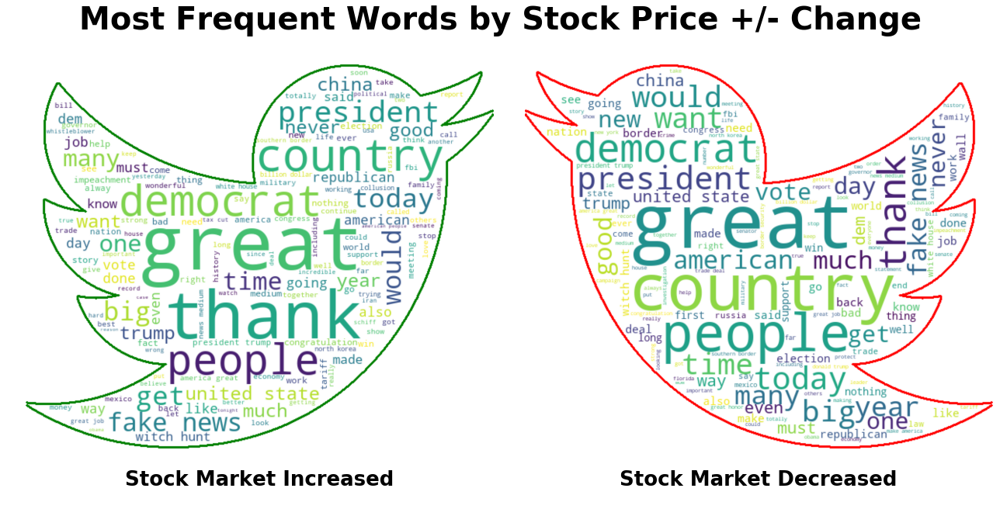

figured saved as figures/wordcloud_figure  05-28-2020 20-24-53.png


In [34]:
# Generate wordclouds
twitter_df_groups,twitter_group_text = ji.get_group_texts_for_word_cloud(nlp_df, 
                                                                      text_column='cleaned_stopped_lemmas', 
                                                                      groupby_column='delta_price_class')


ji.compare_word_clouds(text1=twitter_df_groups['pos']['joined'],
                       label1='Stock Market Increased',
                       text2= twitter_df_groups['neg']['joined'],
                       label2='Stock Market Decreased',
                       twitter_shaped = True, verbose=1,
                       suptitle_y_loc=0.75,
                       suptitle_text='Most Frequent Words by Stock Price +/- Change',
                       wordcloud_cfg_dict={'collocations':True},
                       save_file=True,filepath_folder='',
#                        png_filename=file_dict['nlp_figures']['word_clouds_compare'],
                      **{'subplot_titles_fontdict':{'fontsize':26,'fontweight':'bold'},
                        'suptitle_fontdict':{'fontsize':40,'fontweight':'bold'},
                         'group_colors':{'group1':'green','group2':'red'},
                        });

Unique Text1 Words,Frequency
shifty,25
bank,22
bishop,13
project,11
impeaching,10
mitt,10
church,10
singapore,9
anchor,9
shame,9


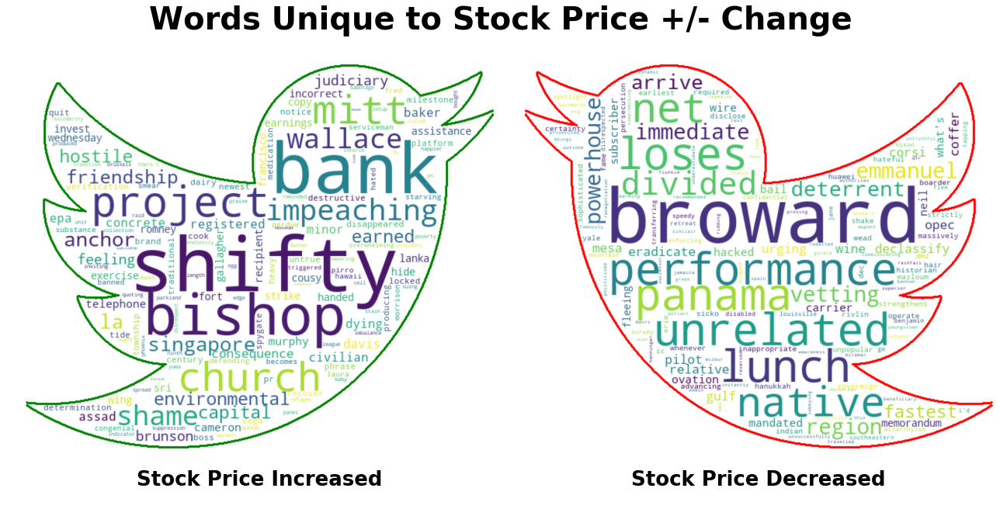

figured saved as figures/wordcloud_figure  05-28-2020 20-24-56.png


In [35]:
## Comparing words ONLY unique to each group
df_pos_words, df_neg_words = ji.compare_freq_dists_unique_words(text1=twitter_df_groups['pos']['text_tokens'],
                                                                label1='Price Increased',
                                                                text2=twitter_df_groups['neg']['text_tokens'],
                                                                label2='Price Decreased',
                                                                top_n=20, display_dfs=True,
                                                                return_as_dicts=False)

pos_freq_dict, neg_freq_dict = ji.compare_freq_dists_unique_words(text1=twitter_df_groups['pos']['text_tokens'],
                                                                label1='Price Increased',
                                                                text2=twitter_df_groups['neg']['text_tokens'],
                                                                label2='Price Decreased',
                                                                top_n=20, display_dfs=False,
                                                                return_as_dicts=True)


## WORDCLOUD OF WORDS UNIQUE TO TWEETS THAT INCREASED VS DECREASED STOCK PRICE
ji.compare_word_clouds(text1= pos_freq_dict,label1='Stock Price Increased',
                       text2=neg_freq_dict, label2='Stock Price Decreased',
                       twitter_shaped=True, from_freq_dicts=True,
                       suptitle_y_loc=0.75,wordcloud_cfg_dict={'collocations':True},
                       suptitle_text='Words Unique to Stock Price +/- Change',
                       save_file=True,filepath_folder='',
#                        png_filename=file_dict['nlp_figures']['word_clouds_compare_unique'],
                       **{'subplot_titles_fontdict':
                         {'fontsize':26,
                         'fontweight':'bold'},
                        'suptitle_fontdict':{
                         'fontsize':40,
                         'fontweight':'bold'},
                         'group_colors':{
                             'group1':'green','group2':'red'}
                        });

In [36]:
ji.make_tweet_bigrams_by_group(twitter_df_groups)

,Frequency
Bigram,
fake news,0.00303572
united states,0.00247264
witch hunt,0.00173819
white house,0.0014689
president trump,0.00129752
america great,0.00122408
border security,0.00107719
north korea,0.00107719
great job,0.00102823


# INITIAL MODELING

## TWEET DELTA PRICE CLASSIFICATON

### Creating Word Embeddings with Word2Vec

- Good Parameters for Non-Retweets:
```python
params = {
'text_column': 'cleaned_stopped_lemmas',
'window':3,
'min_count':2,
'epochs':10,
'sg':1, 
'hs':0,
'negative':5,
'ns_exponent':-0.5
}
```

In [37]:
# func_list = [ji.make_word2vec_model,ji.get_wv_from_word2vec,
#             ji.get_w2v_kwargs,ji.Word2vecParams]
# # ihelp_menu(func_list)
# ji.save_ihelp_menu_to_file(func_list,'_word2vec')

In [38]:
## Loading custom class for tracking Word2Vec parameters
w2vParams = ji.Word2vecParams()        
w2vParams.params_template()

[i] call .params_template() for dict to copy/pate.
#TEMPLATE(call.show_info() for details:

        w2vparams = {
        'text_column': 'cleaned_stopped_lemmas',
        'window':3-5,
        'min_count':1-3,
        'epochs':10-20,
        'sg':0 or 1, 
        'hs':'0 or 1,
        'negative': 0 or 5-20 ,
        'ns_exponent':-1.0 to 1.0
        }


In [39]:
reload(ji,bs)

Reloading functions_combined_BEST...


## Word Math

In [40]:
# fs.ihelp(ji.make_word2vec_model,0)

In [41]:
# fs.ihelp(ji.make_word2vec_model)

In [42]:
twitter_df['cleaned_stopped_content']

date
2016-12-01 14:37:57                 thoughts prayers affected tragic storms tornadoes southeastern united states stay safe
2016-12-01 14:38:09                   getting ready leave great state indiana meet hard working wonderful people carrier c
2016-12-01 22:52:10                                               heading bank arena cincinnati ohio pm rally join tickets
2016-12-02 02:45:18                                thank ohio together made history real work begins america start winning
2016-12-03 00:44:20                            president taiwan called today wish congratulations winning presidency thank
                                                                      ...                                                 
2019-12-30 22:23:04                             fake news always fredo us release dishonest interviews coupled bad ratings
2019-12-31 00:57:13    prayers families victims congregation yesterday church attack seconds thanks brave parishioners ...
2019-12-31 

In [43]:
from gensim.models import Word2Vec

# def make_word2vec_model(df, 
text_column='cleaned_stopped_content'
regex_pattern ="([a-zA-Z]+(?:'[a-z]+)?)"
verbose=0
vector_size=300
window=3
min_count=1
workers=3
epochs=10
summary=True
return_full=False

#     """    w2v_params = {'sg':1, #skip-gram=1
#                 'hs':0, #1=heirarchyical softmarx, if 0, and 'negative' is non-zero, use negative sampling
#                 'negative': 5, # number of 'noisy" words to remove by negative sampling
#                 'ns_exponent': 0.75, # value between -1 to 1. 0.0 samples all words equaly, 
#                 1.0 samples proportional to frequency, negative value=lowfrequency words sampled more
#     }"""


## Regexp_tokenize text_column
from nltk import regexp_tokenize
text_data = twitter_df[text_column].apply(lambda x: regexp_tokenize(x, regex_pattern))
text_data

date
2016-12-01 14:37:57     [thoughts, prayers, affected, tragic, storms, tornadoes, southeastern, united, states, stay, safe]
2016-12-01 14:38:09     [getting, ready, leave, great, state, indiana, meet, hard, working, wonderful, people, carrier, c]
2016-12-01 22:52:10                                     [heading, bank, arena, cincinnati, ohio, pm, rally, join, tickets]
2016-12-02 02:45:18                    [thank, ohio, together, made, history, real, work, begins, america, start, winning]
2016-12-03 00:44:20                  [president, taiwan, called, today, wish, congratulations, winning, presidency, thank]
                                                                      ...                                                 
2019-12-30 22:23:04                 [fake, news, always, fredo, us, release, dishonest, interviews, coupled, bad, ratings]
2019-12-31 00:57:13    [prayers, families, victims, congregation, yesterday, church, attack, seconds, thanks, brave, pa...
2019-12-31 

#### Word2Vec params
```python
## For initializing model
sentences=None,
    size=100,
    alpha=0.025,
    window=5,
    min_count=5,
    max_vocab_size=None,
    sample=0.001,
    seed=1,
    workers=3,
    min_alpha=0.0001,
    sg=0,
    hs=0,
    negative=5,
    cbow_mean=1,
    hashfxn=<built-in function hash>,
    iter=5,
    null_word=0,
    trim_rule=None,
    sorted_vocab=1,
    batch_words=10000,
    compute_loss=False,
    callbacks=(),
    
    
## For training 
    sentences,
    total_examples=None,
    total_words=None,
    epochs=None,
    start_alpha=None,
    end_alpha=None,
    word_count=0,
    queue_factor=2,
    report_delay=1.0,
    compute_loss=False,
    callbacks=(),
    ```

In [44]:
## Instantiate Word2Vec Model
from gensim.models import Word2Vec

model_kws = {
    'sg':1, #skip-gram=1
    'hs':0, #1=heirarchyical softmarx, if 0, and 'negative' is non-zero, use negative sampling
    'negative': 5, # number of 'noisy" words to remove by negative sampling
    # 'ns_exponent': 0.75, # value between -1 to 1. 0.0 samples all words equaly, 1.0 samples proportional to frequency, negative value=lowfrequency words sampled more
     # 'text_column': 'cleaned_stopped_lemmas',
    'window':3,
    'min_count':2,
    # 'epochs':10,
    'sg':1, 
    'hs':0,
    'negative':5,
#     'ns_exponent':-0.5
}

train_kws=dict(epochs=10)

params = dict(model_kws=model_kws,train_kws=train_kws)
[print(f"{k}:\n{v}") for k,v in params.items()];

grid = dict(model_kws={'sg':[0,1],
                       'hs':[0,1],
                       'window':[3,4,5],
                       'min_count':[0,1,2,3],
                       'negative':[3,5,10]
                      },
            train_kws={'epochs':[5,10,20]})

for kw,list_vals in grid['model_kws'].items():
            pass
            

model_kws:
{'sg': 1, 'hs': 0, 'negative': 5, 'window': 3, 'min_count': 2}
train_kws:
{'epochs': 10}


In [45]:
## CREATE AND TRAIN WORD2VEC
VECTOR_SIZE = 300

wv_keras = Word2Vec(text_data, size=VECTOR_SIZE,  workers=-1,**params['model_kws'])
res = wv_keras.train(text_data,total_examples=wv_keras.corpus_count, **params['train_kws'])

## Get vectors
wv = wv_keras.wv
vocab_size = len(wv_keras.wv.vocab)
print(f'There are {vocab_size} words in vocabulary.')

There are 6636 words in vocabulary.


In [46]:
WORD2VECTOR=wv.vocab
VECTOR2WORD = {v:k for k,v in WORD2VECTOR.items()}

In [47]:
### USING WORD VECTOR MATH TO GET A FEEL FOR QUALITY OF MODE
def get_vector(string):#,wv=wv):
    return wv.get_vector(string)


def get_similar(vector):#,wv=wv):
    return wv.similar_by_vector(vector)


def check_vocab(word):
    return word in WORD2VECTOR
check_vocab('hillary')

True

In [48]:
res = get_vector('democrat') + ((get_vector('hillary') - get_vector('bill')))
wv.similar_by_vector(res)

[('democrat', 0.6120328307151794),
 ('hillary', 0.5745675563812256),
 ('yemen', 0.20307184755802155),
 ('talented', 0.18967296183109283),
 ('loopholes', 0.18449115753173828),
 ('shake', 0.18367436528205872),
 ('inconceivable', 0.18363191187381744),
 ('verified', 0.1832442432641983),
 ('mac', 0.17719700932502747),
 ('status', 0.17516526579856873)]

In [50]:
def word_math(word1='hillary',math='-',word2='bill',
              verbose=True,return_vec=False):
    print('---'*15)

    print(f"[i] Result for:\t{word1} {math} {word2}=")
    print('---'*15)

    if check_vocab(word1) & check_vocab(word2):
        eval_eqn = f"get_vector('{word1}') {math} get_vector('{word2}')"
    else:
        print('Error: word not in vocab')
    
    ans_vec =  eval(eval_eqn)
    answer = wv.similar_by_vector(ans_vec)
    
    if verbose:
        [print(f"- {ans[0]} \t\t(similarity={round(ans[1],3)}") for ans in answer]
    print('---'*15,'\n\n')

    if return_vec: return answer
    


equation_list=[('america','+','crime'),
               ('democrats','+','russia'),
               ('republican','-','honor'),
               ('man','+','power'),
               ('russia','+','honor'),
              ('china','+','tariff')]

for eqn in equation_list:
    word_math(*eqn)

---------------------------------------------
[i] Result for:	america + crime=
---------------------------------------------
- america 		(similarity=0.717
- crime 		(similarity=0.685
- behind 		(similarity=0.191
- amazon 		(similarity=0.184
- burr 		(similarity=0.173
- scientists 		(similarity=0.171
- here's 		(similarity=0.168
- myer 		(similarity=0.167
- alternative 		(similarity=0.165
- loosen 		(similarity=0.165
--------------------------------------------- 


---------------------------------------------
[i] Result for:	democrats + russia=
---------------------------------------------
- russia 		(similarity=0.734
- democrats 		(similarity=0.72
- reverend 		(similarity=0.216
- advice 		(similarity=0.207
- payments 		(similarity=0.199
- ultimately 		(similarity=0.192
- promised 		(similarity=0.19
- embassy 		(similarity=0.186
- destruction 		(similarity=0.179
- columbus 		(similarity=0.177
--------------------------------------------- 


---------------------------------------------

In [ ]:
### Testing Word2Vec training params



### Using Pre-Trained GloVe Twitter Vectors

#### Comparing Word Math W2V vs Glove

- Pre-Trained GloVe Twitter download http://nlp.stanford.edu/data/glove.twitter.27B.zip

In [ ]:
# ## Save Glove Twitter Vectors to A Glove File For Word Math
# folder_for_vectors ='/Users/jamesirving/Datasets/glove.twitter.27B/'
# glove_file = 'glove.twitter.27B.100d.txt'

# # define full input glove and output word2vec filepaths
# glove_filepath = folder_for_vectors+glove_file
# w2v_filepath = folder_for_vectors+'glove_to_w2vec.txt'
# print(w2v_filepath)
# print(glove_filepath)

# ## Load in saved glove vectors using KeyedVectors.load_word2vec_format()
# from gensim.models import Word2Vec, KeyedVectors
# from gensim.scripts.glove2word2vec import glove2word2vec
# glove2word2vec(glove_filepath,w2v_filepath)
# glovew2v_model = KeyedVectors.load_word2vec_format(w2v_filepath)
# wvg = glovew2v_model.wv

In [ ]:
# ## ADDING PRETRAINED GLOVE EMBEDDINGS
# fp = r'/Users/jamesirving/Datasets/glove.twitter.27B/glove.twitter.27B.100d.txt'
# word2index, embedding_matrix_gl = ji.load_glove_embeddings(fp,encoding='utf-8',embedding_dim=100,X_train=X_train)

# vocab_size = embedding_matrix_gl.shape[0]
# vector_size = embedding_matrix_gl.shape[1]

### Class Balancing

In [ ]:
## Select smaller subset of twitter_df for df_tokenize
columns_for_model_0 = ['delta_price_class','delta_price','pre_tweet_price',
                       'post_tweet_price','delta_time','B_ts_rounded','B_ts_post_tweet','content',
                       'content_min_clean','cleaned_stopped_content','cleaned_stopped_tokens',
                       'cleaned_stopped_lemmas','delta_price_class_int']

df_tokenize=twitter_df[columns_for_model_0].copy()
ji.check_class_balance(df_tokenize,'delta_price_class_int',as_raw=True, as_percent=False)
ji.check_class_balance(df_tokenize,'delta_price_class',as_raw=False)

In [ ]:
# ji.save_ihelp_to_file(ji.undersample_df_to_match_classes)
ihelp_menu([ji.undersample_df_to_match_classes])

In [ ]:
## RESTRICTING TIME DELTAS FOR MODEL
remove_delta_time_tweets=True

## RESAMPLING 
undersample_to_match_classes = True#True
class_column='delta_price_class'
class_list_to_keep = None # None=all classes or ['neg','pos']

## Display results
show_tweet_versions = True


print('[0] INITIAL CLASS COUNTS.')
## Print initial class balance
ji.check_class_balance(df_tokenize,col=class_column);

## REMOVE TWEETS BASED ON TIME BETWEEN TWEET AND STOCK PRICE VALUE
if remove_delta_time_tweets:
    ## SAMPLE ONLY TWEETS WITHIN 1 DAY OF STOCK MARKET PRICE DATA
    df_sampled = df_tokenize.loc[df_tokenize['delta_time']<'1 day']
    print(f"[1] # OF DAYS REMOVED BY 'delta_time' = {df_tokenize.shape[0]-df_sampled.shape[0]}")
    ji.check_class_balance(df_sampled, col=class_column, as_raw=True, as_percent=False)
else:
    print('[1] Skipping removing tweets by time_delta')
    df_sampled = df_tokenize
    
    
## UNDERSAMPLE FROM UNBALANCED CLASSES
if undersample_to_match_classes:
    
    ## Print status
    if class_list_to_keep is None:
        print_class_list= list(df_sampled[class_column].unique())
    else:
        print_class_list = class_list_to_keep
    print(f'[2] RESAMPLING DF TO MATCH SMALLEST CLASS.\n\tBalancing: {print_class_list}')
    
    ## RESAMPLE TO MATCH CLASSES
    df_sampled = ji.undersample_df_to_match_classes(df_sampled,
                                                    class_column=class_column,
                                                    class_values_to_keep=class_list_to_keep,verbose=0)
    ji.check_class_balance(df_sampled,col=class_column, as_percent=False)
    
    
else:
    print('\n[2] Skipping balancing classes and keeping all 3 classes.')

## Display final output
dash = '---'*20
print(f"\n\n [i] Final class balance:")
ji.check_class_balance(df_sampled,col=class_column)

display(df_sampled.head(2))

show_tweet_versions=True
if show_tweet_versions:
    ji.display_same_tweet_diff_cols(df_sampled,
                                    columns = ['content' ,'content_min_clean',
                                               'cleaned_stopped_content',
                                               'cleaned_stopped_tokens',
                                              'cleaned_stopped_lemmas'],as_md=True)     

In [ ]:
ji.check_class_balance(df_sampled)

### Tokenization, X,y train-test-split

In [ ]:
# ## 
# wv = ji.get_wv_from_word2vec(word2vec_model)
# print(f'Word2Vec Model:\n\tThere are {len(wv.vocab)} words with vector size {wv.vector_size}.')

In [ ]:
# fname = 'shared_memory/df_sampled_test_nlp_models.csv'
# df_sampled.to_csv(fname)

In [ ]:
from keras.preprocessing.text import Tokenizer
from keras.preprocessing import text, sequence
from keras.utils import to_categorical
text_data = df_sampled['cleaned_stopped_lemmas']

# Changed for class imblanace  #
y = to_categorical(df_sampled['delta_price_class_int'],num_classes=3)
print(f'y.shape={y.shape}')
tokenizer = Tokenizer(num_words=len(wv.vocab))

## FIGURE OUT WHICH VERSION TO USE WITH SERIES:
tokenizer.fit_on_texts(text_data)
# return integer-encoded sentences
X = tokenizer.texts_to_sequences(text_data)
X = sequence.pad_sequences(X)
MAX_SEQUENCE_LENGTH = X.shape[1]
print(f'Sequence length: {MAX_SEQUENCE_LENGTH}')

## Save word indices
word_index = tokenizer.index_word
reverse_index = {v:k for k,v in word_index.items()}

In [ ]:
## Get training/test split
X_train, X_test,X_val, y_train, y_test,y_val = ji.train_test_val_split(X, y, test_size=0.15, val_size=0.15)

# ji.check_y_class_balance(data=[y_train,y_test])
print('Training Data:')
print(X_train.shape, y_train.shape)
print('Test Data:')
print(X_test.shape, y_test.shape)
print('Val Data:')
print(X_val.shape, y_val.shape)

## Model 0

In [ ]:
def save_best_nlp_model(model):
    model_key='nlp_model_for_predictions'
    filename = file_dict[model_key]['base_filename']
    nlp_files = ji.save_model_weights_params(model0,check_if_exists=True,auto_increment_name=True, 
                                         auto_filename_suffix=True,filename_prefix=filename)
    return nlp_files


In [ ]:
func_list = [ji.make_keras_embedding_layer]
ihelp_menu(func_list)
ji.save_ihelp_to_file(func_list[0])

### MAKE KERAS EMBEDDING LAYERS FOR GLOVE AND WORD2VEV


In [ ]:
ji.inspect_variables(locals())

In [ ]:
## Make Word2Vec embedding matrix for keras
embedding_matrix_wv = ji.make_embedding_matrix(wv_keras)
print(f'wv:\n\tshape={embedding_matrix_wv.shape}')


## MAKE WORD2VEC EMBEDDING LAYER
from keras import layers         
## Make word2vec embedding layer
vocab_size = embedding_matrix_wv.shape[0]#len(wv.vocab)
vector_size = embedding_matrix_wv.shape[1]#wv.vector_size

embedding_layer_wv =layers.Embedding(vocab_size,#+1
                                  vector_size,
                                  input_length=X_train.shape[1],
                                  weights=[embedding_matrix_wv],
                                  trainable=False)

### Model 0 - Word2Vec

In [ ]:
## KERAS LSTM WITH WORD2VEC EMBEDDING
from keras import callbacks, models, layers, optimizers, regularizers
## Make model infrastructure:
model0_wv = models.Sequential()

## Get and add embedding_layer
model0_wv.add(embedding_layer_wv)
# model0_wv.add(layers.SpatialDropout1D(0.2))

# model0_wv.add(layers.Bidirectional(layers.LSTM(units=100, return_sequences=True,
#                        dropout=0.5,recurrent_dropout=0.2,
#                        kernel_regularizer=regularizers.l2(.01))))
model0_wv.add(layers.Bidirectional(layers.LSTM(units=100, return_sequences=False,
                       dropout=0.3,recurrent_dropout=0.2,
                       kernel_regularizer=regularizers.l2(.01))))

model0_wv.add(layers.Dense(3, activation='softmax'))

model0_wv.compile(loss='categorical_crossentropy',optimizer="rmsprop",metrics=['acc']) #optimizer="adam"
model0_wv.summary()

In [ ]:
reload([ji,bs])

In [ ]:
## set params
num_epochs = 10
# validation_split = 0.2


clock = bs.Clock()
clock.tic()
dashes = '---'*20
print(f"{dashes}\n\tFITTING MODEL:\n{dashes}")

history0_wv = model0_wv.fit(X_train, y_train, 
                      epochs=num_epochs,
                      verbose=True, 
                      validation_data=(X_val,y_val),#validation_split=validation_split,
                      batch_size=100)#,
#                       callbacks=callbacks)

clock.toc()

In [ ]:
cm_fname = 'models/model_0A/fig_conf_mat.ext'
hist_fname = 'models/model_0A/fig_keras_history.ext'
summary_fname ='models/model_0A/model_summary'

df_class_report0A_wv, fig0A_wv=ji.evaluate_classification_model(model0_wv,
                                                   X_train, X_test,
                                                   y_train, y_test, 
                                                                history=history0_wv,
#                                                    report_as_df=False,
                                                   binary_classes=False,
                                                   conf_matrix_classes=['Decrease','No Change','Increase'],
                                                   normalize_conf_matrix=True, 
                                                   save_history=True, history_filename=hist_fname,
                                                   save_conf_matrix_png=True, conf_mat_filename=cm_fname,
                                                   save_summary=True,summary_filename=summary_fname)

### Model 0 - GloVe

In [ ]:
## MAKE GloVe EMBEDDING LAYER
# word2index, embedding_matrix_gl = ji.load_glove_embeddings(fp,encoding='utf-8',embedding_dim=100)

def load_glove_embedding_layer(fp=None, trainable=False):
    if fp is None:
        fp = r'/Users/jamesirving/Datasets/glove.twitter.27B/glove.twitter.27B.100d.txt'

    ## Make GloVe embedding matrix
    word2index, embedding_matrix_gl = ji.load_glove_embeddings(fp=fp,encoding='utf-8',embedding_dim=100)
    print(f'gl:\n\tshape={embedding_matrix_gl.shape}')

    from keras import layers         
    vocab_size = embedding_matrix_gl.shape[0]#len(wv.vocab)
    vector_size = embedding_matrix_gl.shape[1]#wv.vector_size

    embedding_layer_gl =layers.Embedding(vocab_size,#+1,
                                      vector_size,
                                      input_length=X_train.shape[1],
                                      weights=[embedding_matrix_gl],
                                      trainable=trainable)
    return word2index, embedding_layer_gl

# glove_word2index, embedding_layer_gl = load_glove_embedding_layer(trainable=True)
glove_word2index, embedding_layer_gl = load_glove_embedding_layer(trainable=False)


In [ ]:
from keras import callbacks, models, layers, optimizers, regularizers
## Make model infrastructure:
model0_gl = models.Sequential()

## Get and add embedding_layer
model0_gl.add(embedding_layer_gl)
model0_gl.add(layers.SpatialDropout1D(0.2))

# model0_gl.add(layers.Bidirectional(layers.LSTM(units=100, return_sequences=True,
#                        dropout=0.5,recurrent_dropout=0.2,
#                        kernel_regularizer=regularizers.l2(.01))))
model0_gl.add(layers.Bidirectional(layers.LSTM(units=100, return_sequences=False)))#,
#                        dropout=0.5,recurrent_dropout=0.2)))#,
#                        kernel_regularizer=regularizers.l2(.01))))

model0_gl.add(layers.Dense(3, activation='softmax'))

model0_gl.compile(loss='categorical_crossentropy',optimizer="adadelta",metrics=['acc']) #optimizer=""rmsprop""
model0_gl.summary()

In [ ]:
## set params
num_epochs = 15
# validation_split = 0.2
clock = bs.Clock()
clock.tic()
dashes = '---'*20
print(f"{dashes}\n\tFITTING MODEL:\n{dashes}")

history0_gl = model0_gl.fit(X_train, y_train, 
                      epochs=num_epochs,
                      verbose=True, 
                      validation_data=(X_val,y_val),#validation_split=validation_split,
                      batch_size=100)
                      

clock.toc()

cm_fname = file_dict['model_0A']['fig_conf_mat.ext']
hist_fname = file_dict['model_0A']['fig_keras_history.ext']
summary_fname = file_dict['model_0A']['model_summary']

df_class_report0A_gl,fig0A_gl=ji.evaluate_classification(model0_gl,history0_gl,
                                                   X_train, X_test,
                                                   y_train, y_test, 
                                                   report_as_df=False,
                                                   binary_classes=False,
                                                   conf_matrix_classes=['Decrease','No Change','Increase'],
                                                   normalize_conf_matrix=True, 
                                                   save_history=True, history_filename=hist_fname,
                                                   save_conf_matrix_png=True, conf_mat_filename=cm_fname,
                                                   save_summary=True,summary_filename=summary_fname)

In [ ]:
y_pred_model0_gl = model0_gl.predict(X_test)

In [ ]:
np.mean(np.array([0.47, 0.42, 0.18]))

In [ ]:
my_custom_scorer(y_test, y_pred_model0_gl)
# np.mean[[0.47058824, 0.42307692 0.18253968]]

In [ ]:
def save_best_nlp_model(model):
    model_key='nlp_model_for_predictions'
    filename = file_dict[model_key]['base_filename']
    nlp_files = ji.save_model_weights_params(model0,check_if_exists=True,auto_increment_name=True, 
                                         auto_filename_suffix=True,filename_prefix=filename)
    return nlp_files


In [ ]:
save_me_as_model_0A=True
save_me_as_pred_nlp = False

ji.reload(ji)
if save_me_as_pred_nlp:
    model_key='nlp_model_for_predictions'

elif save_me_as_model_0A:
    model_key='model_0A'    
    
filename = file_dict[model_key]['base_filename']
nlp_files = ji.save_model_weights_params(model0_gl,check_if_exists=True,auto_increment_name=True, 
                                         auto_filename_suffix=True,filename_prefix=filename)

file_dict[model_key]['output_filenames'] = nlp_files

ji.update_file_directory(file_dict)

### Kera's Example Pretrained Word Embeddings Network

#### CNN Parameters 
https://machinelearningmastery.com/best-practices-document-classification-deep-learning/

- See notebook `keras_hyperparameter_tuning.ipynb`for gridsearch

```python
# Create HyperParaemeter Space
params_to_search ={'filter_size':[3,4,5,6],
                   'activation':['relu','tanh','linear'],
                   'n_filters':[100,200],#,300,400],
                  'dropout':[0.2],
                  'optimizer':['adam','rmsprop','adadelta'],
                'epochs':[10]}


create_model(embedding_layer=embedding_layer_gl,trainable=False,
              n_filters=100, filter_size=4,
              activation='tanh', optimizer='adadelta',
              dropout=0.2,l2_lr=0.01,
              batch_size=100,
              epochs=10,verbose = 0,show_summary=False)
best results={'activation': 'tanh', 
              'dropout': 0.2,
              'epochs': 10,
              'filter_size': 4,
              'n_filters': 100,
              'optimizer': 'adadelta'}
```

##### Things to Try:
1. Weight Regularization (L2):3 
2. Adadelta Optimizer

In [ ]:
params_to_search ={'filter_size':[3,4,5,6],
                   'activation':['relu','tanh','linear'],
                   'n_filters':[100,200],#,300,400],
                  'dropout':[0.2],
                  'optimizer':['adam','rmsprop','adadelta'],
                'epochs':[10]}

def model_cnn(embedding_layer, X_train, X_test,
              y_train,y_test,
              X_val, y_val,
              n_filters=128, filter_size=4,
              activation='relu', optimizer='rmsprop',
              dropout=0.2,l2_lr=0.01,
              batch_size=128,
              epochs=10,verbose = 1,trainable_embedding=False,show_summary=False):
    
    from keras.layers import Input, Conv1D,GlobalMaxPooling1D, MaxPooling1D, Dense, Dropout
    from keras.models import Model
    from keras.regularizers import l2
    embedding_layer.trainable=trainable_embedding
    print(f'Embedding layer trainable={embedding_layer.trainable}')

    print('Training model.')
    MAX_SEQUENCE_LENGTH = X_train.shape[1]

    # train a 1D convnet with global maxpooling
    sequence_input = Input(shape=(MAX_SEQUENCE_LENGTH,), dtype='int32')
    embedded_sequences = embedding_layer_gl(sequence_input)
    ## Specify layer parameters


    ##
    x = Conv1D(n_filters, filter_size, activation=activation, data_format='channels_first',
               kernel_regularizer=l2(l2_lr), bias_regularizer=l2(l2_lr))(embedded_sequences)
    
    x = Dropout(dropout)(x)
    x = MaxPooling1D(filter_size)(x)
    
    ##
    x = Conv1D(n_filters, filter_size, activation=activation,data_format='channels_first',
              kernel_regularizer=l2(l2_lr), bias_regularizer=l2(l2_lr))(x) 
    x = Dropout(dropout)(x)
    x = MaxPooling1D(filter_size)(x)
    
    ##
    x = Conv1D(n_filters, filter_size, activation=activation,data_format='channels_first',
              kernel_regularizer=l2(l2_lr), bias_regularizer=l2(l2_lr))(x) 
    x = Dropout(dropout)(x)
    x = GlobalMaxPooling1D()(x)
    
    ##
    x = Dense(n_filters, activation='relu')(x) #128
    preds = Dense(3, activation='softmax')(x)

    model = Model(sequence_input, preds)
    model.compile(loss='categorical_crossentropy',
                  optimizer=optimizer, #'rmsprop',#adam
                  metrics=['acc'])
    
    if show_summary:
        display(model.summary())
    
    
    
    clock = bs.Clock()
    clock.tic(f'units={n_filters}, filter={filter_size},dropout={dropout},opt={optimizer}')
    history = model.fit(X_train, y_train,
                        batch_size=batch_size,
                        epochs=epochs,verbose=verbose,
                        validation_data=(X_val,y_val))

              #validation_split=0.1)
    clock.toc('')
    df_class_report0_CNN,fig0_CNN=ji.evaluate_classification(model,history,
                                                       X_train, X_test,
                                                       y_train, y_test, 
                                                       report_as_df=False,
                                                       binary_classes=False,
                                                       conf_matrix_classes=['Decrease','No Change','Increase'],
                                                       normalize_conf_matrix=True)
    
    return model, df_class_report0_CNN

In [ ]:
## Get a trainable embedding_layer with GloVe Emebddings
_,embedding_layer_gl=load_glove_embedding_layer(trainable=False)


## Save the initial weights before any training
gl_initial_weights = embedding_layer_gl.get_weights()

In [ ]:
## Use results from grid search
best_results={'activation': 'tanh', 
              'dropout': 0.2,
              'epochs': 10,
              'filter_size': 4,
              'n_filters': 100,
              'optimizer': 'adadelta'}
outputs= model_cnn(embedding_layer_gl,
                   X_train, X_test,
                   y_train, y_test, 
                   X_val,y_val,l2_lr=0.005,
                   trainable_embedding=False,
                   
                   **best_results)

In [ ]:



def create_model(embedding_layer=embedding_layer_gl,trainable=False,
              n_filters=128, filter_size=4,
              activation='relu', optimizer='rmsprop',
              dropout=0.2,l2_lr=0.01,
              batch_size=100,
              epochs=10,verbose = 0,show_summary=False):
    
    embedding_layer.trainable=trainable
    print(f'Embedding layer trainable={embedding_layer.trainable}')
    from keras.layers import Input, Conv1D,GlobalMaxPooling1D, MaxPooling1D, Dense, Dropout
    from keras.models import Model
    from keras.regularizers import l2

    print('Training model.')
    MAX_SEQUENCE_LENGTH = X_train.shape[1]

    # train a 1D convnet with global maxpooling
    sequence_input = Input(shape=(MAX_SEQUENCE_LENGTH,), dtype='int32')
    embedded_sequences = embedding_layer(sequence_input)
    ## Specify layer parameters


    ##
    x = Conv1D(n_filters, filter_size, activation=activation, data_format='channels_first',
               kernel_regularizer=l2(l2_lr), bias_regularizer=l2(l2_lr))(embedded_sequences)
    
    x = Dropout(dropout)(x)
    x = MaxPooling1D(filter_size)(x)
    
    ##
    x = Conv1D(n_filters, filter_size, activation=activation,data_format='channels_first',
              kernel_regularizer=l2(l2_lr), bias_regularizer=l2(l2_lr))(x) 
    x = Dropout(dropout)(x)
    x = MaxPooling1D(filter_size)(x)
    
    ##
    x = Conv1D(n_filters, filter_size, activation=activation,data_format='channels_first',
              kernel_regularizer=l2(l2_lr), bias_regularizer=l2(l2_lr))(x) 
    x = Dropout(dropout)(x)
    x = GlobalMaxPooling1D()(x)
    
    ##
    x = Dense(n_filters, activation=activation )(x) #128'relu'
    preds = Dense(3, activation='softmax')(x)

    model = Model(sequence_input, preds)
    model.compile(loss='categorical_crossentropy',
                  optimizer=optimizer, #'rmsprop',#adam
                  metrics=['acc'])
    
    if show_summary:
        display(model.summary())
    return model



In [ ]:
def fit_model(model,X_train,y_train,batch_size,epochs,verbose,validation_data):
    
    clock = bs.Clock()
#     clock.tic(f'units={n_filters}, filter={filter_size},dropout={dropout},opt={optimizer}')
    history = model.fit(X_train, y_train,
                        batch_size=batch_size,
                        epochs=epochs,verbose=verbose,
                        validation_data=(X_val,y_val))

              #validation_split=0.1)
    clock.toc('')
    df_class_report0_CNN,fig0_CNN=ji.evaluate_classification(model,history,
                                                       X_train, X_test,
                                                       y_train, y_test, 
                                                       report_as_df=False,
                                                       binary_classes=False,
                                                       conf_matrix_classes=['Decrease','No Change','Increase'],
                                                       normalize_conf_matrix=True)
    
    return model, df_class_report0_CNN

In [ ]:
def my_custom_scorer(y_true,y_pred, model=None, **kwargs):
    """My custom score function to use with sklearn's GridSearchCV
    Maximizes the average accuracy per class using a normalized confusion matrix"""
    from sklearn.metrics import make_scorer,confusion_matrix
    
    # set labels if provided
    if 'labels' in kwargs:
        labels = kwargs['labels']
    else:
        labels=np.unique(y_true)
    
    if y_true.ndim>1 or y_pred.ndim>1:
    
        ## reduce dimensions of y_train and y_test
        if y_true.ndim>1:            
            y_true = y_true.argmax(axis=1)
        if y_pred.ndim>1:
            y_pred = y_pred.argmax(axis=1)
            
    # Get confusion matrx
    cm = confusion_matrix(y_true, y_pred)
    
    # Normalize confusion matrix
    cm_norm = cm.astype('float')/cm.sum(axis=1)[:,np.newaxis]
    
    ## Get diagonals for class accuracy
    diag = cm_norm.diagonal()
    score = np.mean(diag)
    print(f'Mean Class Accuracy = {score}')
    print(f'Class Accuracy Values:')
    print(diag)    
    
    
    ji.plot_confusion_matrix(cm,normalize=True)
    
    return score

In [ ]:
y_pred_model0_gl = model0_gl.predict(X_test)
score, cm_norm = my_custom_scorer(y_test,y_pred_model0_gl)
print(cm_norm, cm_norm.shape)

In [ ]:
from sklearn.model_selection import GridSearchCV
tune_clock = bs.Clock()
from keras import models, layers
from keras.wrappers.scikit_learn import KerasClassifier, KerasRegressor
from sklearn.metrics import make_scorer
from sklearn.model_selection import GridSearchCV

neural_network = KerasClassifier(build_fn=create_model,verbose=2)    

best_results={'activation': ['tanh'], 
              'dropout': [0.2],
              'epochs': [10,15],#,20]
              'filter_size': [4,7],
              'batch_size':[50,100,300],
              'n_filters': [100,300],
              'optimizer': ['adadelta'],
             'l2_lr':[0.005,0.003,0.03]}
grid = GridSearchCV(estimator=neural_network,param_grid=best_results,scoring=make_scorer(my_custom_scorer))

tune_clock.tic()
grid_result = grid.fit(X_train, y_train)
tune_clock.toc()

In [ ]:
grid.best_params_

- REsults from overnight gridsearch
-params ran:
```python
params={'activation': ['tanh'], 
              'dropout': [0.2],
              'epochs': [10,15],#,20]
              'filter_size': [4,7],
              'batch_size':[50,100,300],
              'n_filters': [100,300],
              'optimizer': ['adadelta'],
             'l2_lr':[0.005,0.003,0.03]}
```
- best _params

```python

{'activation': 'tanh',
 'batch_size': 100,
 'dropout': 0.2,
 'epochs': 10,
 'filter_size': 4,
 'l2_lr': 0.005,
 'n_filters': 100,
 'optimizer': 'adadelta'}
```

In [ ]:
## Use results from grid search
best_results={'activation': 'tanh', 
              'dropout': 0.2,
              'epochs': 10,
              'filter_size': 4,
              'n_filters': 100,
              'l2_lr':0.005,
              'optimizer': 'adadelta'}
outputs= model_cnn(embedding_layer_gl,
                   X_train, X_test,
                   y_train, y_test, 
                   X_val,y_val,
                   trainable_embedding=False,
                   **best_results)

In [ ]:
# help(GridSearchCV)

In [ ]:
print(pd.datetime.now())

# BOOKMARK 09/28/19

In [ ]:

def create_deep_model(embedding_layer=embedding_layer_gl,trainable=False,
                       n_conv_layers=3,n_filters=128, filter_size=4,
                      activation='tanh', optimizer='adadelta',
                      dropout=0.2,l2_lr=0.005,
                      batch_size=100,
                      epochs=10,verbose = 1):
    
    ## Print out parameters used to create model
    vars = locals()
    dashes = '---'*20
    print('\n\n')
    print(dashes)
    now = pd.datetime.now()
    print(now.strftime('%m/%d/%Y-%T'))
    print(vars)    
    
    embedding_layer.trainable=trainable
    print(f'Embedding layer trainable={embedding_layer.trainable}')
    from keras.layers import Input, Conv1D,GlobalMaxPooling1D, MaxPooling1D, Dense, Dropout
    from keras.models import Model
    from keras.regularizers import l2

    print('Training model.')
    MAX_SEQUENCE_LENGTH = X_train.shape[1]

    # train a 1D convnet with global maxpooling
    sequence_input = Input(shape=(MAX_SEQUENCE_LENGTH,), dtype='int32')
    embedded_sequences = embedding_layer(sequence_input)
    ## Specify layer parameters


    ##
    x = Conv1D(n_filters, filter_size, activation=activation, #data_format='channels_first',
               kernel_regularizer=l2(l2_lr), bias_regularizer=l2(l2_lr))(embedded_sequences)
    
    x = Dropout(dropout)(x)
    x = MaxPooling1D(filter_size)(x)
    
    
    
    ## Loop to create n_conv_layers
    
    for n in range(n_conv_layers):
        x = Conv1D(n_filters, filter_size, activation=activation,data_format='channels_first',
                   kernel_regularizer=l2(l2_lr), bias_regularizer=l2(l2_lr))(x) 
        x = Dropout(dropout)(x)
        
        if n==n_conv_layers-1:
            x = GlobalMaxPooling1D()(x)
        else:
            x = MaxPooling1D(filter_size)(x)
    
# #     ##
#     x = Conv1D(n_filters, filter_size, activation=activation,data_format='channels_first',
#               kernel_regularizer=l2(l2_lr), bias_regularizer=l2(l2_lr))(x) 
#     x = Dropout(dropout)(x)
#     x = GlobalMaxPooling1D()(x)
    
    ##
    x = Dense(n_filters, activation=activation )(x) #128'relu'
    preds = Dense(3, activation='softmax')(x)

    model = Model(sequence_input, preds)
    model.compile(loss='categorical_crossentropy',
                  optimizer=optimizer, #'rmsprop',#adam
                  metrics=['acc'])
    
#     if show_summary:
#     print()
    display(model.summary())
    return model



In [ ]:
from sklearn.model_selection import GridSearchCV
tune_clock = bs.Clock()
from keras import models, layers
from keras.wrappers.scikit_learn import KerasClassifier, KerasRegressor
from sklearn.model_selection import GridSearchCV

neural_network_deep = KerasClassifier(build_fn=create_deep_model,verbose=1)

params_deep_model={'n_conv_layers':[3,5],
                  'n_filters': [100,200],
                 'l2_lr':[0.005,0.01],
                  'epochs':[10]}
# params_deep_model={'activation': ['tanh'], 
#                    'n_conv_layers':[3,5],
#                   'dropout': [0.2],
#                   'epochs': [10],#,20]
#                   'filter_size': [4],
#                   'batch_size':[100],
#                   'n_filters': [100,200],
#                   'optimizer': ['adadelta'],
#                  'l2_lr':[0.005,0.01]}
grid = GridSearchCV(estimator=neural_network_deep,param_grid=params_deep_model)#,
#                    n_jobs=3)
print(params_deep_model)

tune_clock.tic()
grid_result = grid.fit(X_train, y_train)
tune_clock.toc()

In [ ]:
results = grid_result.cv_results_
type(results)

In [ ]:
# ihelp(grid_result)

In [ ]:
best_deep_params = grid.best_params_
best_deep_params

In [ ]:
model, results = fit_model(create_deep_model(embedding_layer_gl,**best_deep_params))

In [ ]:
ji.evaluate_classification(grid_result, X_train, X_test, y_train, y_test, 
                           report_as_df=False, binary_classes=False,
                           conf_matrix_classes=['Decrease','No Change','Increase'],
                           normalize_conf_matrix=True)
#                                     /               save_history=True, history_filename=hist_fname,
#                                                    save_conf_matrix_png=True, conf_mat_filename=cm_fname,
#                                                    save_summary=True,summary_filename=summary_fname))

In [ ]:
# cm_fname = file_dict['model_0A']['fig_conf_mat.ext']
# hist_fname = file_dict['model_0A']['fig_keras_history.ext']
# summary_fname = file_dict['model_0A']['model_summary']

# df_class_report0A,fig0A=ji.evaluate_classification(model,history,
#                                                    X_train, X_test,
#                                                    y_train, y_test, 
#                                                    report_as_df=False,
#                                                    binary_classes=False,
#                                                    conf_matrix_classes=['Decrease','No Change','Increase'],
#                                                    normalize_conf_matrix=True, 
#                                                    save_history=True, history_filename=hist_fname,
#                                                    save_conf_matrix_png=True, conf_mat_filename=cm_fname,
#                                                    save_summary=True,summary_filename=summary_fname)

#### Additional Dense Layers after CNN

In [ ]:
##CNN+ MORE DENSE LAYERS
from keras.layers import Input, Conv1D,GlobalMaxPooling1D, MaxPooling1D, Dense, Dropout,Flatten
from keras.models import Model

print('Training model.')
MAX_SEQUENCE_LENGTH = X_train.shape[1]

# train a 1D convnet with global maxpooling
sequence_input = Input(shape=(MAX_SEQUENCE_LENGTH,), dtype='int32')
embedded_sequences = embedding_layer_gl(sequence_input)
## Specify layer parameters
n_units =128
filter_size=4
dropout =0.2
x = Conv1D(n_units, filter_size, activation='relu')(embedded_sequences)
x = Dropout(dropout)(x)
x = MaxPooling1D(filter_size)(x)
x = Conv1D(n_units, filter_size, activation='relu',data_format='channels_first')(x)
x = Dropout(dropout)(x)
x = MaxPooling1D(filter_size)(x)
x = Conv1D(n_units, filter_size, activation='relu')(x)

x = Dropout(dropout)(x)
x = GlobalMaxPooling1D()(x)

# x = Flatten()
x = Dense(1024,activation='relu')(x)
x = Dropout(dropout)(x)
x = Dense(512, activation='relu')(x)
x = Dropout(dropout)(x)

x = Dense(n_units, activation='relu')(x) #128
preds = Dense(3, activation='softmax')(x)

model = Model(sequence_input, preds)
model.compile(loss='categorical_crossentropy',
              optimizer='rmsprop',#'rmsprop',#'adam',#
              metrics=['acc'])
model.summary()

In [ ]:
clock = bs.Clock()
clock.tic('')
history = model.fit(X_train, y_train,
                    batch_size=256,#128,
                    epochs=20,
                    validation_data=(X_val,y_val))
                    
          #validation_split=0.1)
clock.toc('')
df_class_report0_CNN,fig0_CNN=ji.evaluate_classification(model,history,
                                                   X_train, X_test,
                                                   y_train, y_test, 
                                                   report_as_df=False,
                                                   binary_classes=False,
                                                   conf_matrix_classes=['Decrease','No Change','Increase'],
                                                   normalize_conf_matrix=True)


#### Combining Multiple Filters into a Functional CNN Model
- https://medium.com/datadriveninvestor/deep-learning-techniques-for-text-classification-9392ca9492c7 

### Model 0A Summary
Our model had difficulty classifying tweets by `delta_price`, but did perform better than chance (36% accuracy vs chance=33%). We will next attempt to use another type of recurrent-neural-network layer, the Gated Rectifier Unit (GRU).

## Model 0B

In [ ]:
# ## ADDING PRETRAINED GLOVE EMBEDDINGS
# word2index, embedding_matrix = ji.load_glove_embeddings(fp,encoding='utf-8',embedding_dim=100)

# vocab_size = embedding_matrix.shape[0]
# vector_size = embedding_matrix.shape[1]

# from keras import layers         
# embedding_layer =layers.Embedding(vocab_size,#+1,
#                                   vector_size,
#                                   input_length=X_train.shape[1],
#                                   weights=[embedding_matrix],
#                                   trainable=False)

In [ ]:
model0B.get_

In [ ]:
## GRU Model
from keras import models, layers, optimizers, regularizers
model0B = models.Sequential()

## Get and add embedding_layer
# embedding_layer = ji.make_keras_embedding_layer(wv, X_train)
model0B.add(embedding_layer_gl)

model0B.add(layers.SpatialDropout1D(0.5))
model0B.add(layers.Bidirectional(layers.GRU(units=100, dropout=0.5, recurrent_dropout=0.2,return_sequences=True)))
model0B.add(layers.Bidirectional(layers.GRU(units=100, dropout=0.5, recurrent_dropout=0.2)))
model0B.add(layers.Dense(3, activation='softmax'))

model0B.compile(loss='categorical_crossentropy',optimizer="adam",metrics=['acc'])#,'val_acc'])#, callbacks=callbacks)
model0B.summary()

In [ ]:
num_epochs = 5

clock = bs.Clock()
clock.tic()
historyB = model0B.fit(X_train, y_train, epochs=num_epochs, verbose=True, validation_split=0.1,
                     batch_size=300)#, class_weight=class_weight)#callbacks=callbacks,, validation_data=(X_val))
clock.toc()


model_key = "model_0B"
cm_fname = file_dict[model_key]['fig_conf_mat.ext']
hist_fname = file_dict[model_key]['fig_keras_history.ext']
summary_fname = file_dict[model_key]['model_summary']

df_class_report0B, fig0B  = ji.evaluate_classification(model0B, historyB, 
                           X_train, X_test, y_train,y_test,report_as_df=False,
                           conf_matrix_classes=['Decrease','No Change','Increase'],
                           binary_classes=False, normalize_conf_matrix=True, 
                           save_history=True, history_filename=hist_fname, 
                           save_conf_matrix_png=True, conf_mat_filename=cm_fname,
                           save_summary=True,summary_filename=summary_fname)

In [ ]:
save_me_as_model_0B=True
save_me_as_pred_nlp = True

ji.reload(ji)
if save_me_as_pred_nlp:
    model_key='nlp_model_for_predictions'

elif save_me_as_model_0B:
    model_key='model_0B'    
    
filename = file_dict[model_key]['base_filename']
nlp_files = ji.save_model_weights_params(model0B,check_if_exists=True,auto_increment_name=True, 
                                         auto_filename_suffix=True,filename_prefix=filename)

file_dict[model_key]['output_filenames'] = nlp_files

ji.update_file_directory(file_dict)
# ji.dict_dropdown(file_dict)

### Model 0B Summary

The GRU performed better than the LSTM model, with 39% validation accuracy.

In [ ]:
ji.inspect_variables(locals(),show_how_to_delete=False)
del_me= ['one_hot_results','nlp_df','text_data']#list of variable names
for me in del_me:    
    try: 
        exec(f'del {me}')
        print(f'del {me} succeeded')
    except:
        print(f'del {me} failed')
        continue

# STOCK DATA

In [1]:
import os,sys
sys.path.append('py_files/')

## IMPORT MY PUBLISHED PYPI PACKAGE 
import bs_ds as  bs
# import bs_ds_local as bs
from fsds_100719.imports import *
# from bs_ds.imports import *

## IMPORT CUSTOM CAPSTONE FUNCTIONS
import functions_combined_BEST as ji
import functions_io as io

from functions_combined_BEST import ihelp, ihelp_menu,\
reload, inspect_variables

## IMPORT CONVENIENCE/DISPLAY FUNCTIONS
from pprint import pprint
import qgrid
import json
import ipywidgets as widgets

# Import plotly and cufflinks for iplots
import plotly
import cufflinks as cf
from plotly import graph_objs as go
from plotly.offline import iplot
cf.go_offline()

fsds_1007219  v0.7.17 loaded.  Read the docs: https://fsds.readthedocs.io/en/latest/ 


Handle,Package,Description
dp,IPython.display,Display modules with helpful display and clearing commands.
fs,fsds_100719,Custom data science bootcamp student package
mpl,matplotlib,Matplotlib's base OOP module with formatting artists
plt,matplotlib.pyplot,Matplotlib's matlab-like plotting module
np,numpy,scientific computing with Python
pd,pandas,High performance data structures and tools
sns,seaborn,High-level data visualization library based on matplotlib


[i] Pandas .iplot() method activated.


In [2]:
# import os,glob
# files = glob.glob('/Users/jamesirving/Downloads/*.txt')
# files

In [3]:
# headers = pd.read_csv(files[0],nrows=1,sep='\t').columns

# file1 = '/Users/jamesirving/Downloads/IVE_bidask1min (1).txt'
# stock_df = pd.read_csv(file1,sep=',')
# stock_df.columns=headers
# stock_df.head()

# stock_df['Date'] = pd.to_datetime(stock_df["Date"])
# stock_df = stock_df.set_index('Date').loc['2016':]#.head()
# stock_df

In [4]:
# stock_df.to_csv('SP500_1min_03_27_2020.csv')

In [5]:
# raw_stock_df = pd.read_csv('SP500_1min_03_27_2020.csv')
# # Create datetime index
# date_time_index = (stock_df['Date']+' '+stock_df['Time']).rename('date_time_index')
# stock_df['date_time_index'] = pd.to_datetime(date_time_index)
# stock_df.set_index('date_time_index',inplace=True)
# stock_df.to_csv('SP500_1min_03_27_2020.csv')

In [6]:
stock_df = pd.read_csv('SP500_1min_03_27_2020.csv',
                       index_col=0,parse_dates=[0])
stock_df.head()

stock_df = ji.set_timeindex_freq(stock_df,verbose=1)


[i] Filled 850# of rows using method ffill
No Remaining Null Values


## Model 1: Using Price as only feature

### Choosing Appropriate Metrics for Time Series Forecasting

- Due to the estimation of price being a precise regression, accuracy will not be an appropriate metric for judging model performance. 
 - e.g. if the price was \\$ 114.23 and our model predicted \\$ 114.25, our accuracy is 0.<br><br>

- **Thiel's U:**
    - [Source of Equation/Explanation of Metric](https://docs.oracle.com/cd/E57185_01/CBREG/ch06s02s03s04.html)
    - $ U = \sqrt{\frac{\sum_{t=1 }^{n-1}\left(\frac{\bar{Y}_{t+1} - Y_{t+1}}{Y_t}\right)^2}{\sum_{t=1 }^{n-1}\left(\frac{Y_{t+1} - Y_{t}}{Y_t}\right)^2}}$


|Thiel's U Value | Interpretation |
| --- | --- |
| <1 | Forecasting is better than guessing| 
| 1 | Forecasting is about as good as guessing| 
|>1 | Forecasting is worse than guessing|

In [7]:
# stock_df = ji.set_timeindex_freq(stock_df,verbose=1)

In [8]:
fig = ji.plotly_time_series(stock_df, y_col='BidClose',as_figure=True)
stock_df = ji.get_technical_indicators(stock_df,make_price_from='BidClose')
# del raw_stock_df

# SELECT DESIRED COLUMNS
stock_df = stock_df[[
    'price','ma7','ma21','26ema','12ema','MACD','20sd',
    'upper_band','lower_band','ema','momentum']]

# Make stock_price for twitter functions
stock_df.dropna(inplace=True)
ji.index_report(stock_df)
display(stock_df.head(3))

------------------------------------------------------------
	INDEX REPORT:	
------------------------------------------------------------
* Index Endpoints:
	2016-02-01 15:30:00 -- to -- 2020-03-26 15:30:00
* Index Freq:
	<CustomBusinessHour: CBH=09:30-16:30>


,price,ma7,ma21,26ema,12ema,MACD,20sd,upper_band,lower_band,ema,momentum
date_time_index,,,,,,,,,,,
2016-02-01 15:30:00,76.04,74.272653,74.896871,74.488716,74.352426,-0.136289,1.683566,78.264003,71.529739,75.873382,69.04
2016-02-02 09:30:00,74.77,74.288367,74.871429,74.492542,74.362550,-0.129992,1.645993,78.163414,71.579443,75.137794,67.77
2016-02-02 10:30:00,74.33,74.292653,74.843469,74.490337,74.361761,-0.128576,1.614060,78.071590,71.615349,74.599265,67.33


In [9]:
## SPECIFY # OF TRAINING TEST DAYS 
num_test_days=20
num_train_days= 260
### SPECIFY Number of days included in each X_sequence (each prediction)
days_for_x_window=1

# Calculate number of rows to bin for x_windows
periods_per_day = ji.get_day_window_size_from_freq( stock_df, ji.custom_BH_freq() )


## Get the number of rows for x_window 
x_window = periods_per_day * days_for_x_window#data_params['days_for_x_window'] 
print(f'X_window size = {x_window} -- ({days_for_x_window} day(s) * {periods_per_day} rows/day)\n')

## Train-test-split by the # of days
df_train, df_test = ji.train_test_split_by_last_days(stock_df,
                                                     periods_per_day =periods_per_day, 
                                                     num_test_days   = num_test_days,
                                                     num_train_days  = num_train_days,
                                                     verbose=1, iplot=True)

X_window size = 7 -- (1 day(s) * 7 rows/day)

training dates:	2019-03-01 09:30:00 	 2020-02-27 15:30:00 = 1820 rows
test dates:	2020-02-27 15:30:00 	 2020-03-26 14:30:00 = 140 rows


In [ ]:
###### RESCALE DATA USING MinMaxScalers FIT ON TRAINING DATA's COLUMNS ######
display(df_train.head(2).style.set_caption('df_train - pre-scaling'))

scaler_library, df_train = ji.make_scaler_library(df_train, transform=True, verbose=1)

df_test = ji.transform_cols_from_library(df_test, col_list=None,
                                         scaler_library=scaler_library,
                                         inverse=False)
display(df_train.head(2).style.set_caption('df_train - post-scaling'))

# Show transformed dataset
# display( df_train.head(2).round(3).style.set_caption('training data - scaled'))

In [12]:
ihelp(ji.make_train_test_series_gens)

------------------------------------------------------------------------------------
------ HELP ------------------------------------------------------------------------

Help on function make_train_test_series_gens in module functions_keras:

make_train_test_series_gens(train_data_series, test_data_series, x_window, X_cols=None, y_cols='price', n_features=1, batch_size=1, model_params=None, debug=False, verbose=1)

------------------------------------------------------------------------------------
------ SOURCE ----------------------------------------------------------------------


```python
def make_train_test_series_gens(train_data_series,test_data_series,x_window,X_cols = None, y_cols='price',n_features=1,batch_size=1, model_params=None,debug=False,verbose=1):
    
    import functions_combined_BEST as ji

    if model_params is not None:
        if 'data_params' in model_params.keys():
            data_params = model_params['data_params']
            model_params['input_params'] = {}
        else:
            print('data_params not found in model_params')
    ########## Define shape of data by specifing these vars 
    if model_params is not None:
        input_params = {}        
        input_params['n_input'] = data_params['x_window']  # Number of timebins to analyze at once. Note: try to choose # greater than length of seasonal cycles 
        input_params['n_features'] = n_features # Number of columns
        input_params['batch_size'] = batch_size # Generally 1 for sequence data
        n_input =  data_params['x_window']
    else:
        # Get params from data_params_dict
        n_input = x_window


    import functions_combined_BEST as ji
    from keras.preprocessing.sequence import TimeseriesGenerator

    # RESHAPING TRAINING AND TRAINING DATA 
    train_data_index =  train_data_series.index

    if model_params is not None:
        input_params['train_data_index'] = train_data_index

    def reshape_train_data_and_target(train_data_series, X_cols=X_cols, y_cols=y_cols,debug=debug):
        # if only 1 column (aka is a series)
        train_data = []
        train_targets = []
        import pandas as pd
        import numpy as np

        if isinstance(train_data_series, pd.DataFrame):
            # train_data_test = train_data_series.values
            train_data = train_data_series.values
                # if not specified, use all columns for x data
            if X_cols is None:
                train_data = train_data_series.values
            
            else:
                train_data = train_data_series[X_cols].values


            # if not specified, assume 'price' is taret_col
            if y_cols is None:
                y_cols = 'price'
            
            train_targets = train_data_series[y_cols].values
            
            # print(train_targets.ndim)
        elif isinstance(train_data_series, pd.Series): #        if train_data_test.ndim<2: #shape[1] < 2:

            train_data = train_data_series.values.reshape(-1,1)
            train_targets = train_data

            # return train_data, train_targets

        # else: # if train_data_series really a df

        if train_targets.ndim <2: #ndim<2:
            train_targets = train_targets.reshape(-1,1)

        if debug==True:
            print('train_data[0]=\n',train_data[0])
            print('train_targets[0]=\n',train_targets[0])
        return train_data, train_targets


    ## CREATE TIMESERIES GENERATOR FOR TRAINING DATA
    train_data, train_targets = reshape_train_data_and_target(train_data_series, X_cols=X_cols, y_cols=y_cols)

    train_generator = TimeseriesGenerator(data=train_data, targets=train_targets,
                                          length=n_input, batch_size=batch_size )



    # RESHAPING TRAINING AND TEST DATA 
    # test_data = test_data_series.values.reshape(-1,1)
    test_data_index =test_data_series.index
    if model_params is not None:
        input_params['test_data_index'] = test_data_index


    ## CREATE TIMESERIES GENERATOR FOR TEST DATA
    test_data, test_targets = reshape_train_data_and_target(test_data_series, X_cols=X_cols, y_cols=y_cols)

    test_generator = TimeseriesGenerator(data=test_data, targets=test_targets,
                                         length=n_input, batch_size=batch_size )
    
    if model_params is not None:
        model_params['input_params'] = input_params

    if verbose>1:
        ji.display_dict_dropdown(model_params)

    if verbose>0:
        # What does the first batch look like?
        X,y = train_generator[0]
        print(f'Given the Array: \t(with shape={X.shape}) \n{X.flatten()}')
        print(f'\nPredict this y: \n {y}')

    if model_params is not None:
        return train_generator,test_generator, model_params
    else:
        return  train_generator, test_generator

```

In [10]:
# Create timeseries generators
train_generator, test_generator = ji.make_train_test_series_gens( 
    df_train['price'], df_test['price'], 
    x_window=x_window,n_features=1,batch_size=1, verbose=0)

,price,ma7,ma21,26ema,12ema,MACD,20sd,upper_band,lower_band,ema,momentum
date_time_index,,,,,,,,,,,
2019-03-01 09:30:00,109.38,109.382,107.993,107.288,108.764,1.47565,1.30399,110.601,105.385,109.201,102.38
2019-03-01 10:30:00,109.16,109.377,108.014,107.308,108.773,1.46452,1.30213,110.619,105.41,109.174,102.16


[i] Using all columns...


,price,ma7,ma21,26ema,12ema,MACD,20sd,upper_band,lower_band,ema,momentum
date_time_index,,,,,,,,,,,
2019-03-01 09:30:00,0.147071,0.0857323,0,0,0.0299623,0.906601,0.31719,0.0126132,0.00306416,0.139319,0.147071
2019-03-01 10:30:00,0.138302,0.0854804,0.000993835,0.000933667,0.030395,0.903228,0.316557,0.0133342,0.00415874,0.138217,0.138302


Using TensorFlow backend.


In [16]:
from keras.models import Sequential
from keras import optimizers
from keras.layers import Bidirectional, Dense, LSTM, Dropout
from keras.regularizers import l2

# Specifying input shape (size of samples, rank of samples?)
n_input = x_window
n_features = 1 # just stock Price

print(f'input shape: ({n_input},{n_features})')
input_shape=(n_input, n_features)

# Create model architecture
model1 = Sequential()
model1.add(LSTM(units=50, input_shape =input_shape,return_sequences=True))#,kernel_regularizer=l2(0.01),recurrent_regularizer=l2(0.01),
model1.add(LSTM(units=50, activation='relu'))
model1.add(Dense(1))

model1.compile(loss=ji.my_rmse, metrics=['acc'],
              optimizer=optimizers.Nadam())

display(model1.summary())

input shape: (7,1)
Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_4 (LSTM)                (None, 7, 50)             10400     
_________________________________________________________________
lstm_5 (LSTM)                (None, 50)                20200     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 51        
Total params: 30,651
Trainable params: 30,651
Non-trainable params: 0
_________________________________________________________________


None

In [18]:
file_dict=io.def_filename_dictionary()


[i] filename_directory loaded from data/filename_dictionary.json.
------------ Dictionary Contents ------------


interactive(children=(Dropdown(description='dict_to_display', options={'file_directory': {'history': '', 'file…

[i] creating all required folders...


------------------------------------------------------------
	FITTING MODEL:
------------------------------------------------------------
--- CLOCK STARTED @:    03/27/20 - 12:23:44 PM           Label:            --- 
Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where

Epoch 1/5
 - 13s - loss: 0.0378 - acc: 0.0011
Epoch 2/5
 - 11s - loss: 0.0261 - acc: 0.0011
Epoch 3/5
 - 10s - loss: 0.0205 - acc: 0.0011
Epoch 4/5
 - 11s - loss: 0.0165 - acc: 0.0011
Epoch 5/5
 - 11s - loss: 0.0149 - acc: 0.0011
--- TOTAL DURATION   =  0 min, 57.076 sec --- 


Lap #,Start Time,Duration,Label
TOTAL,03/27/20 - 12:23:44 PM,"0 min, 57.076 sec",


------------------------------------------------------------------------------------------
	TRAINING HISTORY:
------------------------------------------------------------------------------------------


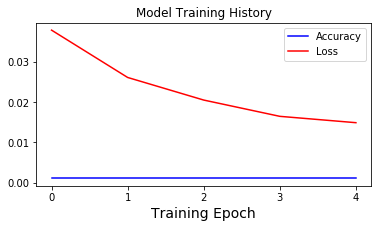

[io] Figure saved as results/model1/model1_keras_history  03-27-2020 12-24-41.png


------------------------------------------------------------------------------------------
	EVALUATE MODEL:
------------------------------------------------------------------------------------------
Evaluating Train Generator:
1813/1813 [==============================] - 4s 2ms/step
    - Accuracy:0.0011
    - Loss:0.0461
Evaluating Test Generator:
133/133 [==============================] - 0s 2ms/step
    - Accuracy:0.0000
    - Loss:0.0178


Metric,Value
R Squared,0.95
Root Mean Squared Error,0.101
Thiel's U,1.268


In [19]:
## FIT MODEL
dashes = '---'*20
print(f"{dashes}\n\tFITTING MODEL:\n{dashes}")

## set params
epochs=5

# override keras warnings
ji.quiet_mode(True,True,True)

# Instantiating clock timer
clock = bs.Clock()
clock.tic('')

# Fit the model
history = model1.fit_generator(train_generator,
                               epochs=epochs,
                               verbose=2, 
                               use_multiprocessing=True,
                               workers=3)

clock.toc('')


model_key = "model_1"
hist_fname = file_dict[model_key]['fig_keras_history.ext']
summary_fname = file_dict[model_key]['model_summary']

# eval_results = ji.evaluate_model_plot_history(model1, train_generator, test_generator)
ji.evaluate_regression_model(model1,history,
                             train_generator=train_generator,
                             test_generator=test_generator,
                            true_test_series=df_test['price'],
                            true_train_series =df_train['price'],
                             save_history=True,history_filename=hist_fname,
                             save_summary=True, summary_filename=summary_fname)

In [20]:
ihelp(ji.evaluate_regression_model)#(model1,history,)

------------------------------------------------------------------------------------
------ HELP ------------------------------------------------------------------------

Help on function evaluate_regression_model in module functions_keras:

evaluate_regression_model(model, history, train_generator, test_generator, true_train_series, true_test_series, include_train_data=True, return_preds_df=False, save_history=False, history_filename='results/keras_history.png', save_summary=False, summary_filename='results/model_summary.txt', auto_unique_filenames=True)
    Evaluates kera's model's performance, plots model's history,displays classification report,
    and plots a confusion matrix. 
    conf_matrix_classes are the labels for the matrix. [negative, positive]
    Returns df of classification report and fig object for  confusion matrix's plot.

------------------------------------------------------------------------------------
------ SOURCE ----------------------------------------------

```python
def evaluate_regression_model(model, history, train_generator, test_generator,true_train_series,
true_test_series,include_train_data=True,return_preds_df = False, save_history=False, history_filename ='results/keras_history.png', save_summary=False, 
                            summary_filename = 'results/model_summary.txt',auto_unique_filenames=True):

    """Evaluates kera's model's performance, plots model's history,displays classification report,
    and plots a confusion matrix. 
    conf_matrix_classes are the labels for the matrix. [negative, positive]
    Returns df of classification report and fig object for  confusion matrix's plot."""

    from sklearn.metrics import roc_auc_score, roc_curve, classification_report,confusion_matrix
    import bs_ds_local as bs
    import functions_combined_BEST as ji
    from IPython.display import display
    import pandas as pd
    import matplotlib as mpl
    numFmt = '.4f'
    num_dashes = 30

    # results_list=[['Metric','Value']]
    # metric_list = ['accuracy','precision','recall','f1']
    print('---'*num_dashes)
    print('\tTRAINING HISTORY:')
    print('---'*num_dashes)

    if auto_unique_filenames:
        ## Get same time suffix for all files
        time_suffix = ji.auto_filename_time(fname_friendly=True)

        filename_dict= {'history':history_filename,'summary':summary_filename}
        ## update filenames 
        for filetype,filename in filename_dict.items():
            if '.' in filename:
                filename_dict[filetype] = filename.split('.')[0]+time_suffix + '.'+filename.split('.')[-1]
            else:
                if filetype =='summary':
                    ext='.txt'
                else:
                    ext='.png'
                filename_dict[filetype] = filename+time_suffix + ext


        history_filename = filename_dict['history']
        summary_filename = filename_dict['summary']


    ## PLOT HISTORY
    ji.plot_keras_history( history,filename_base=history_filename,no_val_data=True, save_fig=save_history,title_text='')

    print('\n')
    print('---'*num_dashes)
    print('\tEVALUATE MODEL:')
    print('---'*num_dashes)

        # # EVALUATE MODEL PREDICTIONS FROM GENERATOR 
    print('Evaluating Train Generator:')
    model_metrics_train = model.evaluate_generator(train_generator,verbose=1)
    print(f'    - Accuracy:{model_metrics_train[1]:{numFmt}}')
    print(f'    - Loss:{model_metrics_train[0]:{numFmt}}')

    print('Evaluating Test Generator:')
    model_metrics_test = model.evaluate_generator(test_generator,verbose=1)
    print(f'    - Accuracy:{model_metrics_test[1]:{numFmt}}')
    print(f'    - Loss:{model_metrics_test[0]:{numFmt}}')

    x_window = test_generator.length
    n_features = test_generator.data[0].shape[0]
    gen_df = ji.get_model_preds_from_gen(model=model, test_generator=test_generator,true_test_data=true_test_series,
        n_input=x_window, n_features=n_features,  suffix='_from_gen',return_df=True)

    regr_results = evaluate_regression(y_true=gen_df['true_from_gen'], y_pred=gen_df['pred_from_gen'],show_results=True,
                                metrics=['r2', 'RMSE', 'U'])


    if save_summary:
        with open(summary_filename,'w') as f:
            model.summary(print_fn=lambda x: f.write(x+"\n"))
            f.write(f"\nSaved at {time_suffix}\n")
            f.write(regr_results.__repr__())


    if include_train_data:
        true_train_series=true_train_series.rename('true_train_price')
        df_all_preds=pd.concat([true_train_series,gen_df],axis=1)
    else:
        df_all_preds = gen_df

    if return_preds_df:
        return df_all_preds

```

In [21]:
reload(ji)
## Get true vs pred data as a dataframe and iplot
df_model1 = ji.get_model_preds_df(model1, 
                                  test_generator = test_generator,
                                  true_train_series = df_train['price'],
                                  true_test_series = df_test['price'],
                                  include_train_data=True,
                                  inverse_tf = True, 
                                  scaler = scaler_library['price'],
                                  preds_from_gen = True, 
                                  preds_from_train_preds = True, 
                                  preds_from_test_preds = True,
                                  iplot = True, iplot_title='Model 1: True Vs Predicted S&P 500 Price',
                                  verbose=0)
    
# Get evaluation metrics
df_results1, dfs_results1, df_shifted1 =\
ji.compare_eval_metrics_for_shifts(df_model1['true_test_price'],
                                   df_model1['pred_from_gen'],
                                   shift_list=np.arange(-4,4,1),
                                   true_train_series_to_add=df_model1['true_train_price'],
                                   display_results=True,
                                   display_U_info=True,
                                   return_results=True,
                                   return_styled_df=True,
                                   return_shifted_df=True)

[i] Using all columns...


<IPython.core.display.Latex object>

|Thiel's U Value | Interpretation |
    | --- | --- |
    | <1 | Forecasting is better than guessing| 
    | 1 | Forecasting is about as good as guessing| 
    |>1 | Forecasting is worse than guessing| 


Pred Shifted,R^2,RMSE,U
-4,0.9285,3.0717,1.7016
-3,0.9411,2.7786,1.5677
-2,0.9544,2.4346,1.3966
-1,0.9807,1.5785,0.9666
0,0.9498,2.5387,1.4667
1,0.9249,3.1053,1.7799
2,0.906,3.469,1.9636
3,0.8812,3.8927,2.2049


In [22]:
df_model1

,true_train_price,true_test_price,pred_from_gen,pred_from_test_preds,pred_from_train_preds
2019-03-01 09:30:00,109.38,NaN,NaN,NaN,NaN
2019-03-01 10:30:00,109.16,NaN,NaN,NaN,NaN
2019-03-01 11:30:00,108.99,NaN,NaN,NaN,NaN
2019-03-01 12:30:00,109.00,NaN,NaN,NaN,NaN
2019-03-01 13:30:00,109.03,NaN,NaN,NaN,NaN
...,...,...,...,...,...
2020-03-26 10:30:00,NaN,95.70,92.634613,133.293155,133.952755
2020-03-26 11:30:00,NaN,96.54,96.128159,133.329746,133.969378
2020-03-26 12:30:00,NaN,96.89,96.332184,133.365243,133.985488
2020-03-26 13:30:00,NaN,95.73,96.779053,133.399675,134.001104


### LOAD IN STOCK DATA WITH INDICATORS

//anaconda3/envs/learn-env-ext/lib/python3.6/site-packages/pandas/plotting/_matplotlib/converter.py:103: FutureWarning:

Using an implicitly registered datetime converter for a matplotlib plotting method. The converter was registered by pandas on import. Future versions of pandas will require you to explicitly register matplotlib converters.

To register the converters:
	>>> from pandas.plotting import register_matplotlib_converters
	>>> register_matplotlib_converters()



(<Figure size 1008x288 with 2 Axes>,
 <matplotlib.axes._subplots.AxesSubplot at 0x1a47414ac8>)

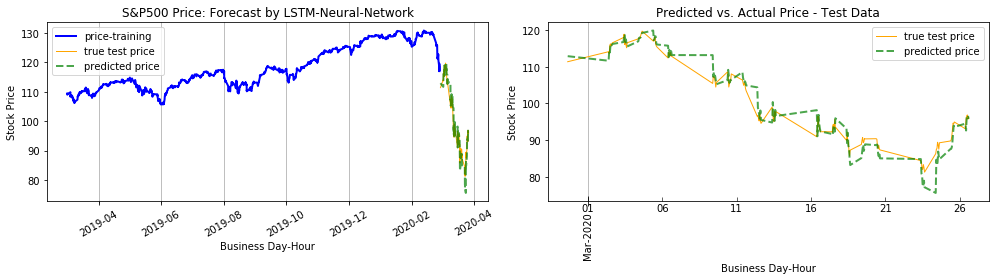

In [24]:
ji.plot_true_vs_preds_subplots(df_model1['true_train_price'], df_model1['true_test_price'],
                                   df_model1['pred_from_gen'])#,
#                                    shift_list=np.arange(-4,4,1),)

In [19]:
# stock_df.to_csv('data/stock_df_with_technical_indicators_03_27_20.csv')


stock_df = pd.read_csv('data/stock_df_with_technical_indicators_03_27_20.csv',
index_col=0,parse_dates=[0])
stock_df = ji.set_timeindex_freq(stock_df,verbose=1)


[i] Filled 0# of rows using method ffill
No Remaining Null Values


In [25]:
ihelp(ji.plot_true_vs_preds_subplots)

------------------------------------------------------------------------------------
------ HELP ------------------------------------------------------------------------

Help on function plot_true_vs_preds_subplots in module functions_combined_BEST:

plot_true_vs_preds_subplots(train_price, test_price, pred_price, figsize=(14, 4), subplots=True, save_fig=False, filename=None, verbose=0)
    #BOOKMARK

------------------------------------------------------------------------------------
------ SOURCE ----------------------------------------------------------------------


```python
def plot_true_vs_preds_subplots(train_price, test_price, pred_price, figsize=(14,4), subplots=True,save_fig=False,filename=None, verbose=0,):
    if save_fig==True and filename is None:
        raise Exception('Must provide filename if save_fig is True')
    from sklearn.metrics import mean_squared_error
    import matplotlib.pyplot as plt
    import matplotlib as mpl
    import numpy as np
    
    # Check for null values
    train_null = train_price.isna().sum()
    test_null = test_price.isna().sum()
    pred_null = pred_price.isna().sum()
    
    null_test = train_null + test_null+pred_null


    if null_test>0:
        
        train_price.dropna(inplace=True)
        test_price.dropna(inplace=True)
        pred_price.dropna(inplace=True)
        
        if verbose>0:
            print(f'Dropping {null_test} null values.')


    ## CREATE FIGURE AND AX(ES)
    if subplots==True:
        # fig = plt.figure(figsize=figsize)#, constrained_layout=True)
        # ax1 = plt.subplot2grid((2, 9), (0, 0), rowspan=2, colspan=4)
        # ax2 = plt.subplot2grid((2, 9),(0,4), rowspan=2, colspan=5)
        fig, (ax1,ax2) = plt.subplots(figsize=figsize, nrows=1, ncols=2, sharey=False)
    else:
        fig, ax1 = plt.subplots(figsize=figsize)

        
    ## Define plot styles by train/test/pred data type
    style_dict = {'train':{},'test':{},'pred':{}}
    style_dict['train']={'lw':2,'color':'blue','ls':'-', 'alpha':1}
    style_dict['test']={'lw':1,'color':'orange','ls':'-', 'alpha':1}
    style_dict['pred']={'lw':2,'color':'green','ls':'--', 'alpha':0.7}
    
    
    # Plot train_price if it is not empty.
    if len(train_price)>0:
        ax1.plot(train_price, label='price-training',**style_dict['train'])
        
        
    # Plot test and predicted price
    ax1.plot(test_price, label='true test price',**style_dict['test'])
    ax1.plot(pred_price, label='predicted price', **style_dict['pred'])#, label=['true_price','predicted_price'])#, label='price-predictions')
    ax1.legend()

    ax1.set_title('S&P500 Price: Forecast by LSTM-Neural-Network')
    ax1.set_xlabel('Business Day-Hour')
    ax1.set_ylabel('Stock Price')

    import matplotlib.dates as mdates
    import datetime

    # Instantiate Locators to be used
    years = mdates.YearLocator()   # every year
    months = mdates.MonthLocator()#interval=2)  # every month
    quarters = mdates.MonthLocator(interval=3)#interval=2)  # every month

    # Define various date formatting to be used
    monthsFmt = mdates.DateFormatter('%Y-%b')
    yearsFmt = mdates.DateFormatter('%Y') #'%Y')
    yr_mo_day_fmt = mdates.DateFormatter('%Y-%m')
    monthDayFmt = mdates.DateFormatter('%m-%d-%y')


    ## AX2 SET TICK LOCATIONS AND FORMATTING

    # Set locators (since using for both location and formatter)
    auto_major_loc = mdates.AutoDateLocator(minticks=5)
    auto_minor_loc = mdates.AutoDateLocator(minticks=10)

    # Set Major X Axis Ticks
    ax1.xaxis.set_major_locator(auto_major_loc)
    ax1.xaxis.set_major_formatter(mdates.AutoDateFormatter(auto_major_loc))

    # Set Minor X Axis Ticks
    ax1.xaxis.set_minor_locator(auto_minor_loc)
    ax1.xaxis.set_major_formatter(mdates.AutoDateFormatter(auto_minor_loc))


    ax1.tick_params(axis='x',which='both',rotation=30)
    ax1.grid(axis='x',which='major')

    # Plot a subplot with JUST the test and predicted prices
    if subplots==True:
        
        ax2.plot(test_price, label='true test price',**style_dict['test'])
        ax2.plot(pred_price, label='predicted price', **style_dict['pred'])#, label=['true_price','predicted_price'])#, label='price-predictions')
        ax2.legend()
        plt.title('Predicted vs. Actual Price - Test Data')
        ax2.set_xlabel('Business Day-Hour')
        ax2.set_ylabel('Stock Price')
        # plt.subplots_adjust(wspace=1)#, hspace=None)[source]¶
        
        ## AX2 SET TICK LOCATIONS AND FORMATTING

        # Major X-Axis Ticks
        ax2.xaxis.set_major_locator(months) #mdates.DayLocator(interval=5))
        ax2.xaxis.set_major_formatter(mdates.DateFormatter('%b-%Y')) #monthsFmt) #mdates.DateFormatter('%m-%Y')) #AutoDateFormatter(locator=locator))#yearsFmt)

        # Minor X-Axis Ticks
        ax2.xaxis.set_minor_locator(mdates.DayLocator(interval=5))#,interval=5))
        ax2.xaxis.set_minor_formatter(mdates.DateFormatter('%d')) #, fontdict={'weight':'bold'})

        # Changing Tick spacing and rotation.
        ax2.tick_params(axis='x',which='major',rotation=90, direction='inout',length=10, pad=5)
        ax2.tick_params(axis='x',which='minor',length=4,pad=2, direction='in') #,horizontalalignment='right')#,ha='left')
        ax2.grid(axis='x',which='major')
    
    # # ANNOTATING RMSE
    # RMSE = np.sqrt(mean_squared_error(test_price,pred_price))
    # bbox_props = dict(boxstyle="square,pad=0.5", fc="white", ec="k", lw=0.5)
    plt.tight_layout()

    # plt.annotate(f"RMSE: {RMSE.round(3)}",xycoords='figure fraction', xy=(0.085,0.85),bbox=bbox_props)
    if save_fig:
        fig.savefig(filename,facecolor='white', format='png', frameon=True)
        print(f'[i] Figure saved as {filename}')
    if subplots==True:
        return fig, ax1,ax2
    else:
        return fig, ax1

```

## Model 2: Stock Price + Technical Indicators

### Technical Indicator Details

In [26]:
# SELECT DESIRED COLUMNS
stock_df = stock_df[[
    'price','ma7','ma21','26ema','12ema','MACD','20sd',
    'upper_band','lower_band','ema','momentum']]

# Make stock_price for twitter functions
stock_df.dropna(inplace=True)
ji.index_report(stock_df)
display(stock_df.head(3))

------------------------------------------------------------
	INDEX REPORT:	
------------------------------------------------------------
* Index Endpoints:
	2016-02-01 15:30:00 -- to -- 2020-03-26 15:30:00
* Index Freq:
	<CustomBusinessHour: CBH=09:30-16:30>


,price,ma7,ma21,26ema,12ema,MACD,20sd,upper_band,lower_band,ema,momentum
date_time_index,,,,,,,,,,,
2016-02-01 15:30:00,76.04,74.272653,74.896871,74.488716,74.352426,-0.136289,1.683566,78.264003,71.529739,75.873382,69.04
2016-02-02 09:30:00,74.77,74.288367,74.871429,74.492542,74.362550,-0.129992,1.645993,78.163414,71.579443,75.137794,67.77
2016-02-02 10:30:00,74.33,74.292653,74.843469,74.490337,74.361761,-0.128576,1.614060,78.071590,71.615349,74.599265,67.33


In [27]:
fig =ji.plotly_technical_indicators(stock_df,figsize=(900,500))

1. **7 and 21 day moving averages**
```python
df['ma7'] df['price'].rolling(window = 7 ).mean() #window of 7 if daily data
df['ma21'] df['price'].rolling(window = 21).mean() #window of 21 if daily data
```    
2. **MACD(Moving Average Convergence Divergence)**

> Moving Average Convergence Divergence (MACD) is a trend-following momentumindicator that shows the relationship between two moving averages of a security’s price. The MACD is calculated by subtracting the 26-period Exponential Moving Average (EMA) from the 12-period EMA.

>The result of that calculation is the MACD line. A nine-day EMA of the MACD, called the "signal line," is then plotted on top of the MACD line, which can function as a trigger for buy and sell signals. 

> Traders may buy the security when the MACD crosses above its signal line and sell - or short - the security when the MACD crosses below the signal line. Moving Average Convergence Divergence (MACD) indicators can be interpreted in several ways, but the more common methods are crossovers, divergences, and rapid rises/falls.  - _[from Investopedia](https://www.investopedia.com/terms/m/macd.asp)_

```python
df['ewma26'] = pd.ewma(df['price'], span=26)
df['ewma12'] = pd.ewma(df['price'], span=12)
df['MACD'] = (df['12ema']-df['26ema'])
```
3. **Exponentially weighted moving average**
```python
dataset['ema'] = dataset['price'].ewm(com=0.5).mean()
```

4. **Bollinger bands**
    > "Bollinger Bands® are a popular technical indicators used by traders in all markets, including stocks, futures and currencies. There are a number of uses for Bollinger Bands®, including determining overbought and oversold levels, as a trend following tool, and monitoring for breakouts. There are also some pitfalls of the indicators. In this article, we will address all these areas."
> Bollinger bands are composed of three lines. One of the more common calculations of Bollinger Bands uses a 20-day simple moving average (SMA) for the middle band. The upper band is calculated by taking the middle band and adding twice the daily standard deviation, the lower band is the same but subtracts twice the daily std. - _[from Investopedia](https://www.investopedia.com/trading/using-bollinger-bands-to-gauge-trends/)_

    - Boilinger Upper Band:<br>
    $BOLU = MA(TP, n) + m * \sigma[TP, n ]$<br><br>
    - Boilinger Lower Band<br>
    $ BOLD = MA(TP,n) - m * \sigma[TP, n ]$
    - Where:
        - $MA$  = moving average
        - $TP$ (typical price) = $(High + Low+Close)/ 3$
        - $n$ is number of days in smoothing period
        - $m$ is the number of standard deviations
        - $\sigma[TP, n]$ = Standard Deviations over last $n$ periods of $TP$

```python
# Create Bollinger Bands
dataset['20sd'] = pd.stats.moments.rolling_std(dataset['price'],20)
dataset['upper_band'] = dataset['ma21'] + (dataset['20sd']*2)
dataset['lower_band'] = dataset['ma21'] - (dataset['20sd']*2)
```


5. **Momentum**
> "Momentum is the rate of acceleration of a security's price or volume – that is, the speed at which the price is changing. Simply put, it refers to the rate of change on price movements for a particular asset and is usually defined as a rate. In technical analysis, momentum is considered an oscillator and is used to help identify trend lines." - _[from Investopedia](https://www.investopedia.com/articles/technical/081501.asp)_

    - $ Momentum = V - V_x$
    - Where:
        - $ V $ = Latest Price
        - $ V_x $ = Closing Price
        - $ x $ = number of days ago

```python
# Create Momentum
dataset['momentum'] = dataset['price']-1
```

In [28]:
## SPECIFY # OF TRAINING TEST DAYS 
num_test_days=20
num_train_days=260
### SPECIFY Number of days included in each X_sequence (each prediction)
days_for_x_window=1

# Calculate number of rows to bin for x_windows
periods_per_day = ji.get_day_window_size_from_freq( stock_df, ji.custom_BH_freq() )

## Get the number of rows for x_window 
x_window = periods_per_day * days_for_x_window#data_params['days_for_x_window'] 
print(f'X_window size = {x_window} -- ({days_for_x_window} day(s) * {periods_per_day} rows/day)\n')

## Train-test-split by the # of days
df_train, df_test = ji.train_test_split_by_last_days(stock_df,
                                                     periods_per_day =periods_per_day, 
                                                     num_test_days   = num_test_days,
                                                     num_train_days  = num_train_days,
                                                     verbose=1, iplot=True)

X_window size = 7 -- (1 day(s) * 7 rows/day)

training dates:	2019-03-01 09:30:00 	 2020-02-27 15:30:00 = 1820 rows
test dates:	2020-02-27 15:30:00 	 2020-03-26 14:30:00 = 140 rows


In [29]:
###### RESCALE DATA USING MinMaxScalers FIT ON TRAINING DATA's COLUMNS ######
display(df_train.head(2).style.set_caption('df_train - pre-scaling'))

scaler_library, df_train = ji.make_scaler_library(df_train, transform=True, verbose=1)

df_test = ji.transform_cols_from_library(df_test, col_list=None,
                                         scaler_library=scaler_library,
                                         inverse=False)
display(df_train.head(2).style.set_caption('df_train - post-scaling'))

# Show transformed dataset
# display( df_train.head(2).round(3).style.set_caption('training data - scaled'))

# Create timeseries generators
train_generator, test_generator = ji.make_train_test_series_gens( 
    df_train['price'], df_test['price'], 
    x_window=x_window,n_features=1,batch_size=1, verbose=0)

,price,ma7,ma21,26ema,12ema,MACD,20sd,upper_band,lower_band,ema,momentum
date_time_index,,,,,,,,,,,
2019-03-01 09:30:00,109.38,109.382,107.993,107.288,108.764,1.47565,1.30399,110.601,105.385,109.201,102.38
2019-03-01 10:30:00,109.16,109.377,108.014,107.308,108.773,1.46452,1.30213,110.619,105.41,109.174,102.16


[i] Using all columns...


,price,ma7,ma21,26ema,12ema,MACD,20sd,upper_band,lower_band,ema,momentum
date_time_index,,,,,,,,,,,
2019-03-01 09:30:00,0.147071,0.0857323,0,0,0.0299623,0.906601,0.31719,0.0126132,0.00306416,0.139319,0.147071
2019-03-01 10:30:00,0.138302,0.0854804,0.000993835,0.000933667,0.030395,0.903228,0.316557,0.0133342,0.00415874,0.138217,0.138302


In [30]:
## Make new time series generators with all stock_indicators for X_sequences
train_generator, test_generator = ji.make_train_test_series_gens(
    train_data_series=df_train,
    test_data_series=df_test,
    y_cols='price',
    x_window=x_window,
    n_features=len(df_train.columns),
    batch_size=1, verbose=1)

Given the Array: 	(with shape=(1, 7, 11)) 
[0.14707055 0.08573228 0.         0.         0.02996231 0.90660134
 0.3171897  0.01261319 0.00306416 0.13931908 0.14707055 0.13830211
 0.08548039 0.00099384 0.00093367 0.03039497 0.90322834 0.3165573
 0.01333419 0.00415874 0.13821654 0.13830211 0.1315265  0.08508456
 0.00190752 0.00177235 0.03063191 0.89920754 0.31524393 0.0138187
 0.00535473 0.13329285 0.1315265  0.13192507 0.08475171 0.00282121
 0.00260685 0.0308742  0.89524936 0.31345257 0.01418674 0.00667459
 0.13191963 0.13192507 0.13312077 0.08444584 0.0037926  0.00344719
 0.03114353 0.89142903 0.31183384 0.01464766 0.00800375 0.13226592
 0.13312077 0.14029494 0.08420295 0.00479606 0.00436812 0.03160296
 0.88831551 0.30966103 0.01500181 0.00950651 0.13720554 0.14029494
 0.13909924 0.08378913 0.00580271 0.00526402 0.03201885 0.88508367
 0.30730595 0.01531436 0.01105951 0.13804804 0.13909924]

Predict this y: 
 [[0.16221602]]


In [33]:
ihelp(ji.my_rmse)

------------------------------------------------------------------------------------
------ HELP ------------------------------------------------------------------------

Help on function my_rmse in module functions_keras:

my_rmse(y_true, y_pred)
    RMSE calculation using keras.backend

------------------------------------------------------------------------------------
------ SOURCE ----------------------------------------------------------------------


```python
def my_rmse(y_true,y_pred):
    """RMSE calculation using keras.backend"""
    from keras import backend as kb
    sq_err = kb.square(y_pred - y_true)
    mse = kb.mean(sq_err,axis=-1)
    rmse =kb.sqrt(mse)
    return rmse

```

In [31]:
# Create keras model from model_params
import functions_combined_BEST as ji
from keras.models import Sequential
from keras.layers import Bidirectional, Dense, LSTM, Dropout
from IPython.display import display
from keras.regularizers import l2

# Specifying input shape (size of samples, rank of samples?)
n_input = x_window 
n_features = len(df_train.columns) # Using stock_price and technical indicators

print(f'input shape: ({n_input},{n_features}')
input_shape=(n_input, n_features)

# Create model architecture
model2 = Sequential()
model2.add(LSTM(units=50, input_shape =input_shape,return_sequences=True))#,  kernel_regularizer=l2(0.01),recurrent_regularizer=l2(0.01),
# model2.add(Dropout(0.2))
model2.add(LSTM(units=50, activation='relu'))
model2.add(Dense(1))

model2.compile(loss=ji.my_rmse, metrics=['acc',ji.my_rmse],
              optimizer=optimizers.Nadam())

display(model2.summary())

input shape: (7,11
Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_6 (LSTM)                (None, 7, 50)             12400     
_________________________________________________________________
lstm_7 (LSTM)                (None, 50)                20200     
_________________________________________________________________
dense_2 (Dense)              (None, 1)                 51        
Total params: 32,651
Trainable params: 32,651
Non-trainable params: 0
_________________________________________________________________


None

------------------------------------------------------------
	FITTING MODEL:
------------------------------------------------------------ 

--- CLOCK STARTED @:    03/27/20 - 12:38:23 PM           Label:            --- 
Epoch 1/5
1813/1813 [==============================] - 14s 8ms/step - loss: 0.0417 - acc: 0.0011 - my_rmse: 0.0417
Epoch 2/5
1813/1813 [==============================] - 13s 7ms/step - loss: 0.0259 - acc: 0.0011 - my_rmse: 0.0259
Epoch 3/5
1813/1813 [==============================] - 13s 7ms/step - loss: 0.0202 - acc: 0.0011 - my_rmse: 0.0202
Epoch 4/5
1813/1813 [==============================] - 14s 8ms/step - loss: 0.0173 - acc: 0.0011 - my_rmse: 0.0173
Epoch 5/5
1813/1813 [==============================] - 19s 10ms/step - loss: 0.0161 - acc: 0.0011 - my_rmse: 0.0161
--- TOTAL DURATION   =  1 min, 15.184 sec --- 


Lap #,Start Time,Duration,Label
TOTAL,03/27/20 - 12:38:23 PM,"1 min, 15.184 sec",


------------------------------------------------------------------------------------------
	TRAINING HISTORY:
------------------------------------------------------------------------------------------


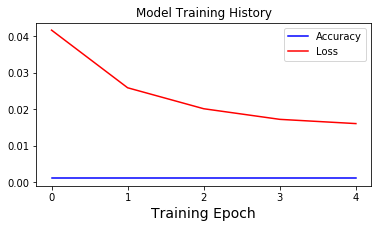

[io] Figure saved as results/model2/model2_keras_history  03-27-2020 12-39-38.png


------------------------------------------------------------------------------------------
	EVALUATE MODEL:
------------------------------------------------------------------------------------------
Evaluating Train Generator:
1813/1813 [==============================] - 7s 4ms/step
    - Accuracy:0.0011
    - Loss:0.0069
Evaluating Test Generator:
133/133 [==============================] - 0s 4ms/step
    - Accuracy:0.0000
    - Loss:0.1172


Metric,Value
R Squared,0.805
Root Mean Squared Error,0.2
Thiel's U,0.892


In [32]:
epochs=5

clock = bs.Clock()
print('---'*20)
print('\tFITTING MODEL:')
print('---'*20,'\n')     

# start the timer
clock.tic('')

# Fit the model
history = model2.fit_generator(train_generator,epochs=epochs) 
clock.toc('')

model_key = "model_2"
hist_fname = file_dict[model_key]['fig_keras_history.ext']
summary_fname = file_dict[model_key]['model_summary']

# eval_results = ji.evaluate_model_plot_history(model1, train_generator, test_generator)
ji.evaluate_regression_model(model2,history,
                             train_generator=train_generator,
                             test_generator=test_generator,
                            true_test_series=df_test['price'],
                            true_train_series =df_train['price'],
                             save_history=True,history_filename=hist_fname,
                             save_summary=True, summary_filename=summary_fname)

In [34]:
## Get true vs pred data as a dataframe and iplot
df_model2 = ji.get_model_preds_df(model2, 
                                  test_generator=test_generator,
                                  true_train_series = df_train['price'],
                                  true_test_series = df_test['price'],
                                  x_window=x_window,
                                  n_features=len(df_train.columns),
                                  scaler=scaler_library['price'],
                                  preds_from_gen=True, 
                                  inverse_tf=True,
                                  iplot=True,  iplot_title='Model 2: True Vs Predicted S&P 500 Price')

# Compare predictions if predictions timebins shifted
df_results2, dfs_results2, df_shifted2 =\
ji.compare_eval_metrics_for_shifts(df_model2['true_test_price'],
                                   df_model2['pred_from_gen'],
                                   shift_list=np.arange(-4,5,1),
                                   true_train_series_to_add=df_model2['true_train_price'],
                                   display_results=True,
                                   return_styled_df=True,
                                   display_U_info=False,
                                   return_shifted_df=True,
                                   return_results=True)

[i] Using all columns...


,true_train_price,true_test_price,pred_from_gen
2019-03-01 09:30:00,109.38,nan,nan
2019-03-01 10:30:00,109.16,nan,nan
2019-03-01 11:30:00,108.99,nan,nan


,true_train_price,true_test_price,pred_from_gen
2020-03-26 12:30:00,nan,96.89,99.5238
2020-03-26 13:30:00,nan,95.73,101.251
2020-03-26 14:30:00,nan,96.23,99.171


Pred Shifted,R^2,RMSE,U
-4,0.7314,5.952,3.3687
-3,0.7853,5.3032,3.0301
-2,0.7335,5.888,3.3314
-1,0.8137,4.908,2.8852
0,0.8047,5.0086,2.9015
1,0.7742,5.386,3.1181
2,0.7719,5.4037,3.1129
3,0.7629,5.4994,3.1673
4,0.746,5.6712,3.268


In [ ]:
# ##SAVING DFS
# ji.save_model_dfs(file_dict,'model_2',
#                df_model=df_model2,
#               df_results=dfs_results2,
#               df_shifted=df_shifted2)

In [35]:
df_results2, dfs_results2, df_shifted2 =\
ji.compare_eval_metrics_for_shifts(df_model2['true_test_price'],
                                   df_model2['pred_from_gen'],
                                   shift_list=np.arange(-4,5,1),
                                   true_train_series_to_add=df_model2['true_train_price'],
                                   display_results=True,
                                   return_styled_df=True,
                                   display_U_info=False,
                                   return_shifted_df=True,
                                   return_results=True)

Pred Shifted,R^2,RMSE,U
-4,0.7314,5.952,3.3687
-3,0.7853,5.3032,3.0301
-2,0.7335,5.888,3.3314
-1,0.8137,4.908,2.8852
0,0.8047,5.0086,2.9015
1,0.7742,5.386,3.1181
2,0.7719,5.4037,3.1129
3,0.7629,5.4994,3.1673
4,0.746,5.6712,3.268


### Model 2: Summary

- Using Stock Price plus technical indicators, and with a prediction time-shift of -1, we achieved:
    - $R^2$ value of 0.98
    - RMSE value of 0.269
    - Thiel's $U$ value of 0.4812
- This means our second model can explain \_\_% of the variance in the data ($R^2$) and that our model performed ~~significantly better~~ than guessing (Thiel's U value ~~<1.0~~)

- It is surprisng that the model's performance is so poor by adding the technical indicators.
    - Further investigation is required to understand why the $R^2$ value is negative. 

# ADDING TRUE FORECAST (03/27/20)

In [ ]:
def keras_forecast(scaled_train_ts, scaled_test_ts, model, n_input, n_feature):
    preds = []
    eval_batch = scaled_train_ts[-n_input:]
    working_batch = eval_batch.reshape(1, n_input, n_feature)
    
    for i in range(len(scaled_test_ts)):
        current_pred = model.predict(working_batch)[0]
        preds.append(current_pred)
        working_batch = np.append(working_batch[:,1:,:], [[current_pred]], axis=1)
        
    return pred

# COMBINING TWEET STATS, NLP CLASSIFICATION, AND MARKET DATA

In [ ]:
# # LOAD IN FULL STOCK DATASET using ClosingBig S&P500 WITH INDEX.FREQ=CBH
# # fname = file_dict['stock_df']['stock_df_with_indicators']
# full_df = ji.load_processed_stock_data(processed_data_filename=fname)

# # SELECT DESIRED COLUMNS
# stock_df = full_df[[
#     'price','ma7','ma21','26ema','12ema','MACD',
#     '20sd','upper_band','lower_band','ema','momentum'
# ]]

# stock_df.head()

# stock_df['date_time'] = stock_df.index.to_series()
# ji.index_report(stock_df)

# stock_df.sort_index(inplace=True)
# display(stock_df.head(2),stock_df.tail(2))
# del full_df
stock_df.head()

In [ ]:
## LOAD IN RAW TWITTER DATA, NO PROCESSING
# from functions_combined_BEST import ihelp_menu2
# # file_dict = ji.load_filename_directory()
raw_tweets = 'data/trump_tweets_12012016_to_01012020.csv'
sp500 = 'data/SP500_1min_01_23_2020.xlsx'
# dft = pd.read_csv(tweets)
# dfs = pd.read_excel(sp500)
np.random.seed(42)

twitter_df= ji.load_raw_twitter_file(filename= raw_tweets,#'data/trump_tweets_12012016_to_01012020.csv'

                                     date_as_index=True,
                                     rename_map={'text': 'content', 'created_at': 'date_time_index'})
twitter_df = ji.check_twitter_df(twitter_df,text_col='content',remove_duplicates=True, remove_long_strings=True)


In [ ]:
# MAKE TIME INTERVALS BASED ON BUSINESS HOUR START (09:30-10:30)
time_intervals= \
ji.make_time_index_intervals(stock_df.reset_index(drop=True),
                             col='date_time_index', 
                             closed='right',
                             return_interval_dicts=False) 
time_intervals